
# <font color='red'>  Machine learning project:
</font>

## Predicting taxonomic identity and genetic composition based on codon usage bias levels


### Morettini Francesco

In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import sklearn
import scipy
from matplotlib.patches import Patch
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.preprocessing import PolynomialFeatures
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyRegressor
from sklearn.metrics import make_scorer
from sklearn.preprocessing import OrdinalEncoder
import time
from sklearn.preprocessing import OrdinalEncoder
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import cross_val_score
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import warnings
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import normalize
from sklearn.cluster import AgglomerativeClustering
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.metrics import confusion_matrix
import random
np.random.seed(0)

C:\Users\franc\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Preliminary analysis

In this dataset we have the frequency of the 64 possible codons across different organisms. They are classified in two different ways, we have 11 classes which represents the Kingdom and 11 which represents the DNA type. The dataset has been already divided into a training set and a test set. In this section the goal is to do some preliminary analysis which are helpful in order to understand the dataset and extract some information. 

The first thing to do is download the data and separate the output from the rest of the data and remove information that are not useful for our analysis.

In [2]:
train_data = pd.read_csv("train.csv")     #Download of the train and test set
test_data = pd.read_csv("test.csv")
train_data
X_train = train_data.iloc[:,6::]          #Only codons frequency is saved in the train matrix
X_test = test_data.iloc[:,6::]
X_train
train_kingdom = train_data.iloc[:,1]      #The kingdom and DNA type columns are stored in specific variables
test_kingdom = test_data.iloc[:,1]
train_DNA_type = train_data.iloc[:,2]
test_DNA_type = test_data.iloc[:,2]

train_kingdom
train_DNA_type

FileNotFoundError: [Errno 2] No such file or directory: 'train.csv'

An easy way to learn something about data is visualize them. In this case we can clearly see how the dataset is pretty unbalanced. Looking at the kingdom we have mainly plants, viruses, bacteria, vertebrates and invertebrates. This is true in both the train and test set. For what is regarding the DNA type we have only 3 of them which are genomic, mithocondrial and chloroplast DNA with a few samples of plastid's DNA.

<Figure size 720x576 with 0 Axes>

<AxesSubplot:xlabel='Kingdom', ylabel='count'>

<Figure size 720x576 with 0 Axes>

<AxesSubplot:xlabel='Kingdom', ylabel='count'>

<Figure size 720x576 with 0 Axes>

<AxesSubplot:xlabel='DNAtype', ylabel='count'>

<Figure size 720x576 with 0 Axes>

<AxesSubplot:xlabel='DNAtype', ylabel='count'>

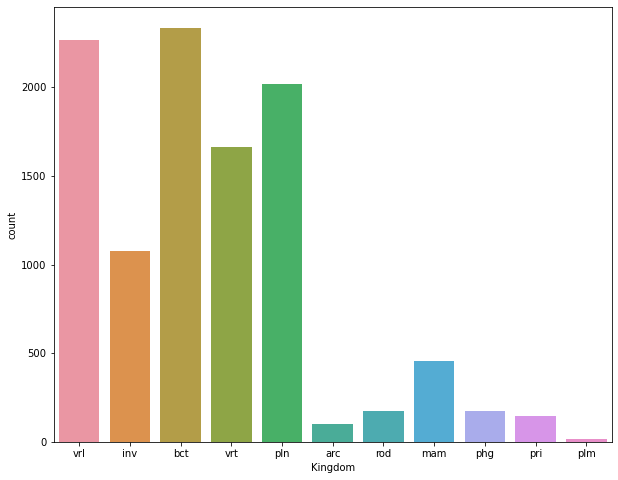

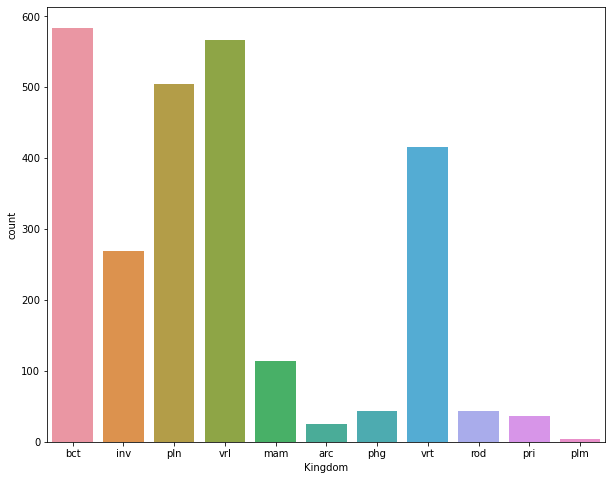

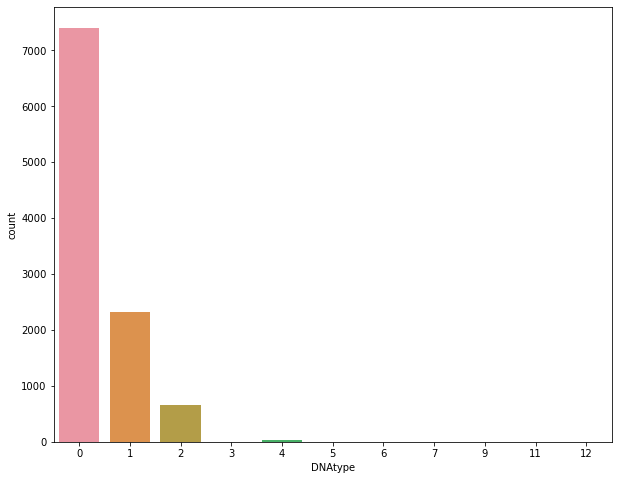

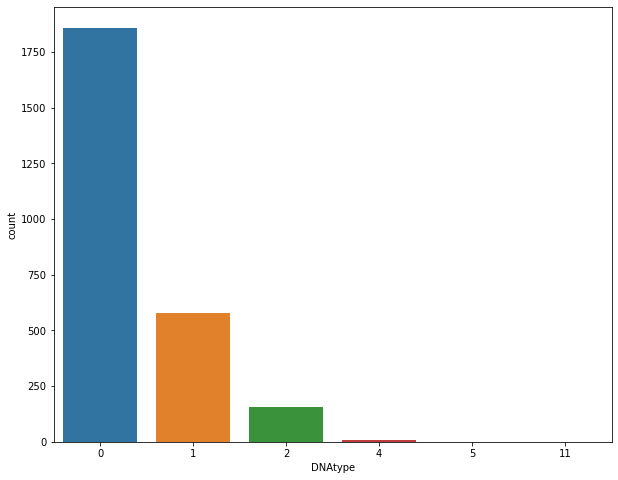

In [3]:
plt.figure(figsize = (10,8))
sns.countplot(x = "Kingdom", data = train_data)
plt.figure(figsize = (10,8))
sns.countplot(x = "Kingdom", data = test_data)
plt.figure(figsize = (10,8))
sns.countplot(x = "DNAtype", data = train_data)
plt.figure(figsize = (10,8))
sns.countplot(x = "DNAtype", data = test_data)

We can also take a look to the correlation between codons, it is difficult to see a pattern in this, however it is pretty clear how some of them are pretty strongly correlated while others like GUU, GCU, GGU, ACC, AAC, CGC and UAA are not correlated with any of the others.

<Figure size 1440x1440 with 0 Axes>

<AxesSubplot:>

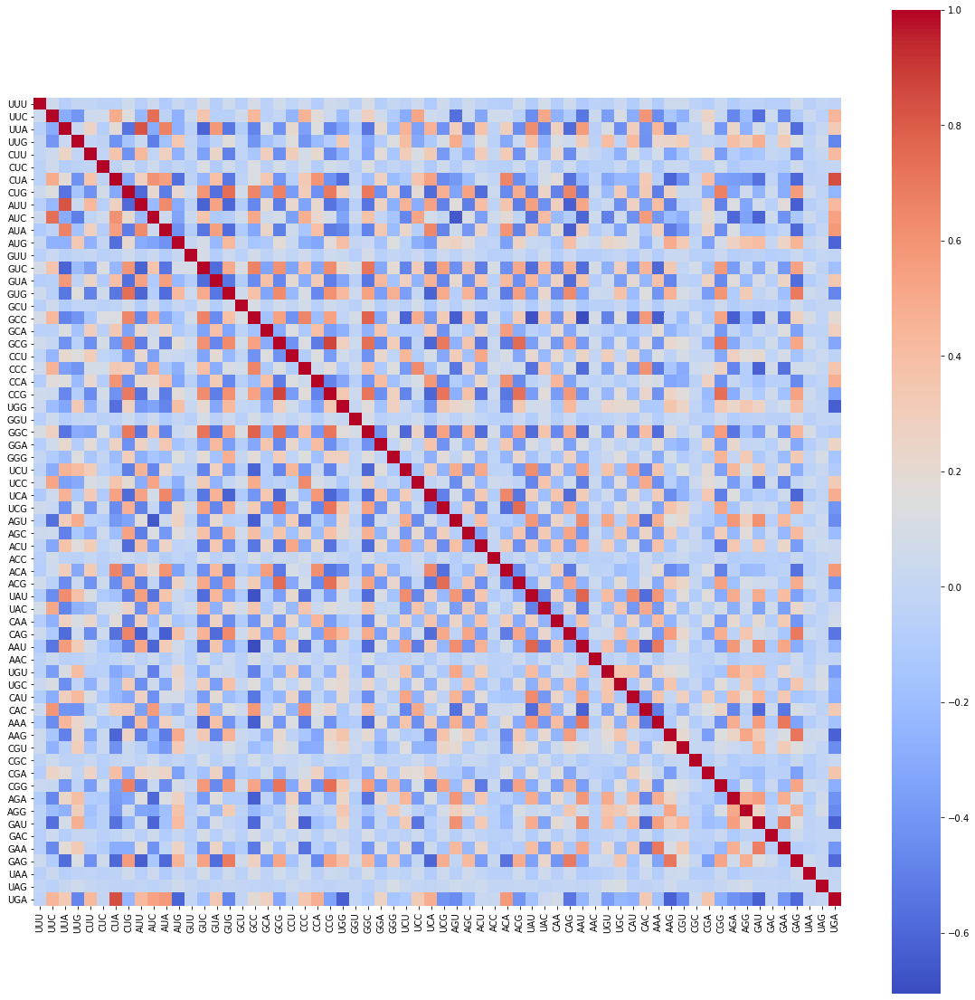

In [4]:
plt.figure(figsize = (20,20))
cormat=X_train.corr()
sns.heatmap(cormat, square=True, cmap = "coolwarm")

### Principal Component Analysis

Since we are dealing with a classification problem we may be interested in understand a priori what kind of result we can get. Having a way to visualize our samples make it possible to understand if it is possible to achieve a low error rate or not. However since we have 64 features we cannot plot all of them, since we have only 3 dimensions. A possible solution is given by the Principal Component Analysis (PCA). The endpoint of the PCA is having a reduced number of features in a different space, in particular since we want to plot our samples, we will consider only 2 principal components.

<Figure size 1440x1440 with 0 Axes>

<AxesSubplot:>

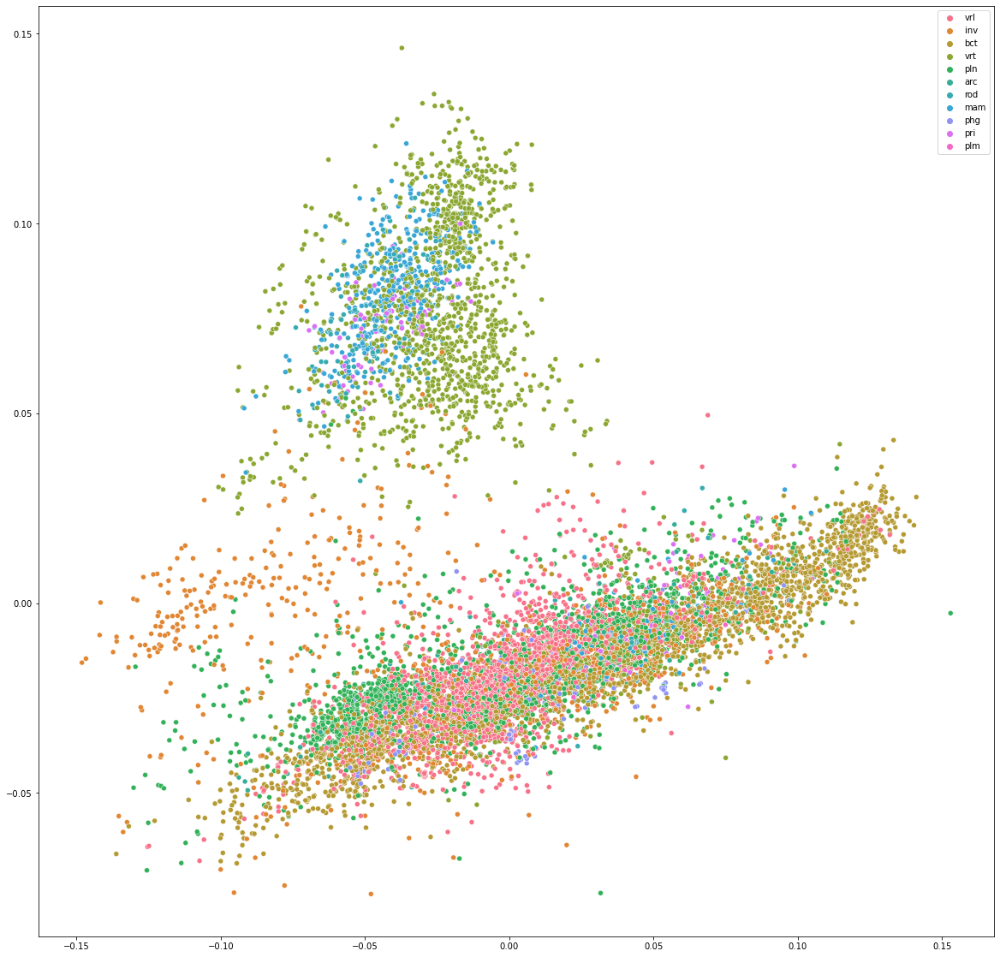

In [5]:
pca = PCA(n_components=2)         #Specifying that we want only 2 components

X_train_PCA = pca.fit_transform(X_train)             #Transform our data in a smaller space and plot the data
X_train_PCA = np.c_[ X_train_PCA, train_kingdom, train_DNA_type ]
plt.figure(figsize = (20,20))
sns.scatterplot(x = X_train_PCA[:,0], y = X_train_PCA[:,1], hue = X_train_PCA[:,2],  data = X_train_PCA)

The plot is very informative since we can see how our samples are disposed in this 2D space. The data are labeled based on their kingdom, we may distinguish 3 different groups in the plot: the upper one which contains vertebrates, mammalian and primates. A lower one which contains mainly virus, bacteria and plants and finally a more sparse one in the middle which contains invertebrates. Basically, looking at only two principal components we can already distinguish 3 different families which is a good result considering that we have many more data to use.

Now we are interested to understand how much of the variance present in the data is explained by our 2 principal components. We also take a look to the number of princiapl components that we need to explain the majority of the variance.

<Figure size 1440x720 with 0 Axes>

Text(0.5, 0, 'Number of Principal Components')

Text(0, 0.5, 'Cumulative variance explained')

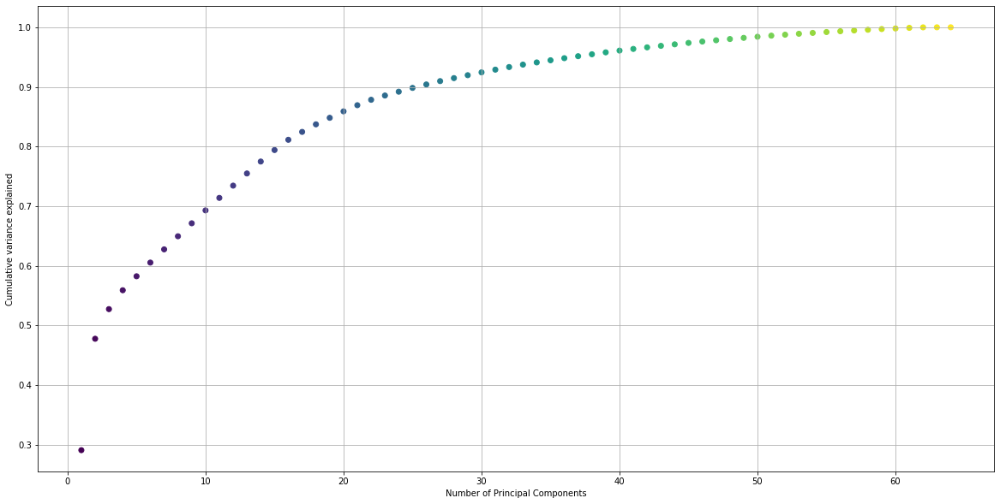

In [6]:
pca = PCA()
X_pca = pca.fit(X_train)
X_prj = pca.fit_transform(X_train)          #Transformation of the data
plt.figure(figsize=(20,10))
cum_var = []                                #Cumulative variance, using all the principal components will yield the 100% of variance 
tot = 0
for i in X_pca.explained_variance_ratio_:
    tot = tot + i
    cum_var.append(tot)
plt.scatter(x = np.arange(1,65),y = cum_var, c = np.arange(1,65))
plt.grid()
plt.xlabel("Number of Principal Components")
plt.ylabel("Cumulative variance explained")

It is possible to see that 2 principal components explain less than 50% of the variance in the data, this is actually a pretty good information since it means that we can have a significant improvment using more pricipal components. An ideal number may be around 25 which guarantees a 90% of explained variance.

### Correlation between variables and the output

Another important aspect is the correlation of the variables with the target classes. This can be done both for the kingdom and DNA type classes. The first thing to do is find the maximum and the minimum of the codon frequency so that we can tune in a better way the color in the plot.

In [7]:
means = np.mean(X_train, axis = 0)           #Compute the mean for every codon frequency
np.max(means)                                #Compute min and max
np.min(means)

0.028477126271349126

0.0005896133179811944

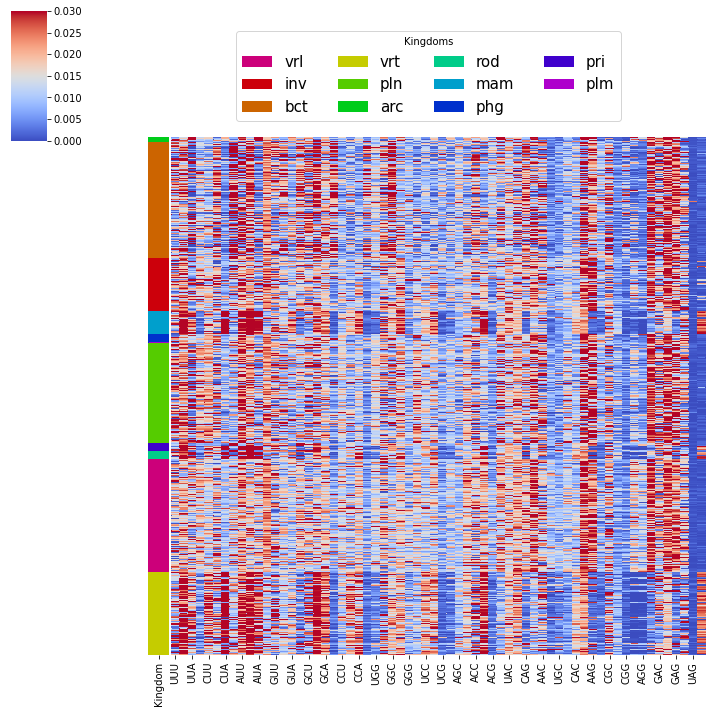

In [8]:
ordered = train_data.sort_values(by = ['Kingdom'])                 #Sort the samples by Kingdom
ordered = ordered.drop(["Unnamed: 0","DNAtype","SpeciesID","Ncodons","SpeciesName"], axis = 1)
lut = dict(zip(train_kingdom.unique(), sns.hls_palette(11, h=.9, l=.4, s=1)))  #Association of every class to a color of the palette
row_colors = train_kingdom.map(lut)
sns.clustermap(data = ordered.iloc[:,1::], row_cluster=False, col_cluster=False, cmap = "coolwarm", row_colors=row_colors, 
               vmin=0, vmax=0.03, yticklabels=False)
handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Kingdoms',loc = "center", ncol = 4, fontsize = 15, markerscale = 1, bbox_to_anchor = (11.6, 0.5))

Even from this plot we can see a behaviour which is very similar to the one observed with the PCA, in fact again we can see a similar pattern between vertebrates, mammalian and primates. In particular we can see a different freqeuncy for some codons like AAG. It may be possible that some codons are associated with specific functions for more complex organisms, another hypothesis could also be a different CG% across those species.

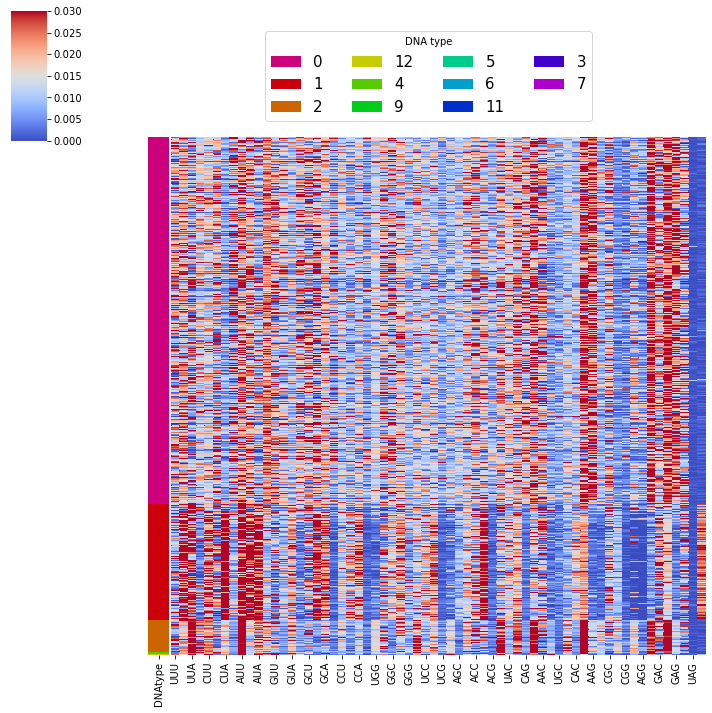

In [9]:
order = train_data.sort_values(by=['DNAtype'])
order = order.drop(["Unnamed: 0","Kingdom","SpeciesID","Ncodons","SpeciesName"], axis = 1)
lut_2 = dict(zip(train_DNA_type.unique(), sns.hls_palette(11, h=.9, l=.4, s=1)))
row_colors_2 = train_DNA_type.map(lut_2)
sns.clustermap(data = order.iloc[:,1::], row_cluster=False, col_cluster=False, cmap = "coolwarm", row_colors=row_colors_2, 
               vmin=0, vmax=0.03, yticklabels=False)
handles_2 = [Patch(facecolor=lut_2[name]) for name in lut_2]
plt.legend(handles_2, lut_2, title='DNA type',loc = "center", ncol = 4, fontsize = 15, markerscale = 1, bbox_to_anchor = (11.6, 0.5))

A fairly interesting pattern is also visible in this plot regarding the DNA type where we can see more extreme codon frequencies for the mitochondrial DNA.

## Clustering

Now that we have started to analyze data we can try to cluster them. As mentioned before we expect that a good clustering algorithm is able to divide at least the 3 big families seen before. To do that we will use both hierarchical and partitive clustering and see which one perform better.

### Hierarchical clustering

The first thing to do is compute the linkage matrix which store inside all the distances between each data point, we start by using one of the most common distance which is the euclidean distance.

In [10]:
# Generate the linkage matrix
Z = linkage(X_train, metric = 'euclidean', method = 'ward')

This function is used to plot the dendrogram that we are going to obtain from the hierarchical algorithm.

In [11]:
def plot_dendrogram(Z=None, model=None, X=None, **kwargs):
    annotate_above = kwargs.pop('annotate_above', 0)

    # Reconstruct the linakge matrix if the standard model API was used
    if Z is None:
        if hasattr(model, 'distances_') and model.distances_ is not None:
            # create the counts of samples under each node
            counts = np.zeros(model.children_.shape[0])
            n_samples = len(model.labels_)
            for i, merge in enumerate(model.children_):
                current_count = 0
                for child_idx in merge:
                    if child_idx < n_samples:
                        current_count += 1  # leaf node
                    else:
                        current_count += counts[child_idx - n_samples]
                counts[i] = current_count

            Z = np.column_stack([model.children_, model.distances_,
                                              counts]).astype(float)
        else:
            Z = linkage(X, method=model.linkage, metric=model.affinity)
    
    if 'n_clusters' in kwargs:
        n_clusters = kwargs.pop('n_clusters')
        # Set the cut point just above the last but 'n_clusters' merge
        kwargs['color_threshold'] = Z[-n_clusters, 2] + 1e-6
    
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(111)
    # Plot the corresponding dendrogram
    ddata = dendrogram(Z, ax=ax, **kwargs) 
    
    # Annotate nodes in the dendrogram
    for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
        x = 0.5 * sum(i[1:3])
        y = d[1]
        nid = np.where(Z[:,2] == y)[0][0]
        if y > annotate_above:
            plt.plot(x, y, 'o', c=c)
            plt.annotate(str(nid-Z.shape[0]), (x, y), xytext=(0, -5),
                         textcoords='offset points',
                         va='top', ha='center')
    if kwargs['color_threshold']:
        plt.axhline(y=kwargs['color_threshold'], c='k')
    
    return fig, ax

With this other function we will be able to inspect all the nodes that we want, in this way we will be able to see what cluster we obtain cutting at different points in the dendrogram.

In [12]:
# Recursively backtrack the dendrogram, collecting
# the list of sample id starting from an initial point

def get_node_leaves(Z, idx, N):
    n1, n2 = Z[idx,0], Z[idx,1]
    leaves = []
    for n in [n1, n2]:
        leaves += [int(n)] if n < N else get_node_leaves(Z, int(n-N), N)
    return leaves

# Plot a number of images (at most maxn) under a cluster/sample id
def plot_node(Z, X, y, idx, maxn=500):
    leaves = get_node_leaves(Z, idx, X.shape[0])
    labels, counts = np.unique(y[leaves], return_counts=True)
    nleaves = len(leaves)
    print(pd.DataFrame(np.array(counts).reshape(1,-1), 
                       columns=labels, index=["Frequency:"]))
    print("Images in the cluster:", len(leaves), "/", X.shape[0])

    random.shuffle(leaves)
    leaves = leaves[:maxn]
    h = min((nleaves // 15)+1, 15)
    w = nleaves if nleaves < 15 else 15
    
    y = pd.DataFrame(y)
    final = pd.DataFrame()
    X = pd.concat([X, y], axis = 1)

    for i in leaves:
        x = pd.DataFrame(X.iloc[i,:])
        final = pd.concat([final, x], axis = 1)
    return pd.DataFrame(final)

Only the last 50 agglomerative step are shown and the horizontal line is cutting at 11 cluster. This number is chosen based on the fact that as we have seen before we have 11 classes both for kingdom and DNA type. Other numbers can be considered since only 3 classes of DNA type are present and some organisms are really similar even if from different kingdoms.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

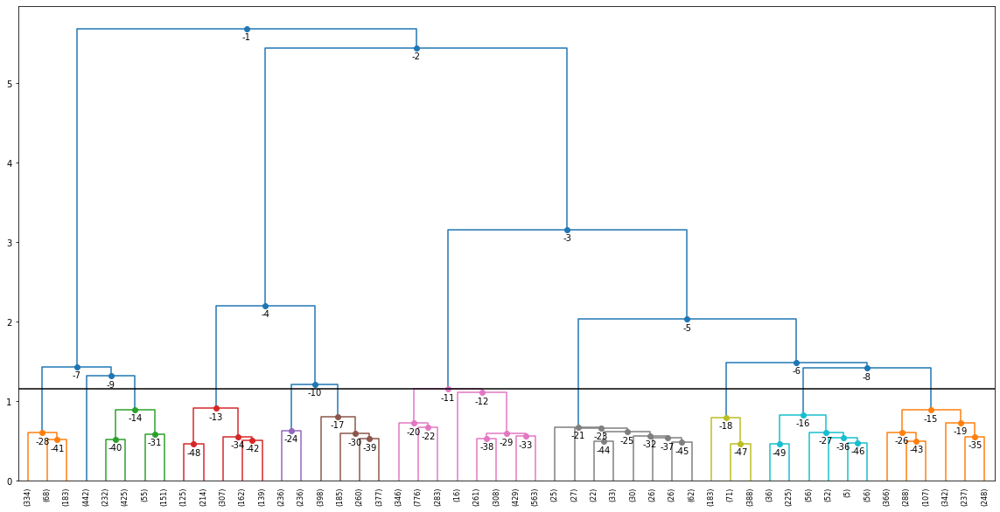

In [13]:
plot_dendrogram(Z = Z, X = X_train,
                truncate_mode = 'lastp', 
                p = 50, n_clusters = 11)

Below the node -9 we can see that we have only few classes and the majority of the organisms present are vertebrates and mammalian. This is concordant with what we have seen before. We can also notice that if we take a look to the classes of DNA type all the the DNA below this node is mitochondrial DNA.
In general if we take a look to the first 15 nodes it is possible to recognise all the different classes across the kingdom classification, we can say that the algorithm seems to work pretty well.

In [14]:
plot_node(Z, X_train, train_kingdom, -9)     #This shows everything below the node -9

            inv  mam  pln  pri  rod  vrt
Frequency:   19  373    3   80  121  709
Images in the cluster: 1305 / 10422


,8165,5804,9309,473,7387,6561,2499,2336,9353,3012,...,1220,4331,1171,1107,1151,9025,10097,6731,3432,9444
UUU,0.00288,0.00168,0.01079,0.0114,0.01053,0.00096,0.00102,0.04903,0.00398,0.00576,...,0.02623,0.00535,0.00032,0.01594,0.01703,0.00558,0.03958,0.00498,0.01156,0.03416
UUC,0.0317,0.04662,0.04236,0.01994,0.05263,0.02791,0.03352,0.04111,0.03768,0.03458,...,0.02993,0.03824,0.02627,0.0255,0.05141,0.04279,0.03694,0.03955,0.00867,0.03605
UUA,0.00865,0.00932,0.02887,0.04368,0.05263,0.03561,0.02238,0.01788,0.01991,0.0147,...,0.04237,0.02632,0.01121,0.03443,0.01157,0.01023,0.03782,0.0249,0.06069,0.03985
UUG,0.0107,0.00149,0.00486,0.02089,0,0,0.00261,0.00715,0.00123,0,...,0.00471,0.00329,0.00128,0.00096,0,0,0,0.00264,0.01156,0.00474
CUU,0.00865,0.0179,0.01592,0.04084,0.01842,0.0308,0.02755,0.01941,0.02022,0.02594,...,0.01446,0.02179,0.01922,0.03953,0.00861,0.0186,0.04925,0.03809,0.04335,0.0389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAG,0,0.00597,0.00459,0,0,0.00192,0.00307,0.00409,0.00153,0.00259,...,0.00269,0.0037,0.0016,0.00765,0.00012,0.00093,0.00264,0.00029,0,0.00285
UAA,0.00288,0.0097,0.0116,0.02849,0.02632,0.0154,0.00386,0.012,0.00705,0,...,0.02858,0.00041,0.06216,0.03507,0.06823,0.03442,0.01319,0.02871,0,0.02751
UAG,0,0.00019,0.00054,0.00285,0,0.00096,0.00034,0.00026,0,0.00288,...,0.00101,0,0,0,0,0,0,0,0,0.00095
UGA,0.02017,0.02741,0.02482,0.02849,0.02895,0.02984,0.02704,0.024,0.02604,0.02594,...,0.02421,0.02961,0.02788,0.02072,0.03419,0.02791,0.0299,0.02989,0.02794,0.02562


In [15]:
plot_node(Z, X_train, train_DNA_type, -9)

               1
Frequency:  1305
Images in the cluster: 1305 / 10422


,9745,4099,5372,2086,4331,6215,2457,2931,5082,8397,...,8273,7505,1257,3698,6818,8300,9220,6458,9632,2773
UUU,0.02457,0.00743,0.00866,0.03209,0.00535,0.01910,0.01479,0.01961,0.00000,0.00558,...,0.02535,0.02100,0.00288,0.01852,0.00000,0.00260,0.00264,0.01186,0.00973,0.00219
UUC,0.03776,0.02578,0.04309,0.03090,0.03824,0.03509,0.02404,0.02408,0.00289,0.01745,...,0.03390,0.06562,0.03746,0.02896,0.01062,0.01183,0.01762,0.04644,0.04233,0.03219
UUA,0.02598,0.02315,0.02550,0.02793,0.02632,0.03704,0.03846,0.02598,0.03468,0.05932,...,0.03687,0.01575,0.00288,0.03906,0.04923,0.08312,0.05903,0.01779,0.02403,0.03511
UUG,0.00262,0.00393,0.00503,0.00951,0.00329,0.00507,0.00666,0.00086,0.00289,0.01117,...,0.00165,0.00000,0.00000,0.00471,0.00386,0.00577,0.00176,0.00000,0.00172,0.00293
CUU,0.01700,0.01791,0.02727,0.01188,0.02179,0.01715,0.02515,0.02064,0.02312,0.02373,...,0.03522,0.02362,0.01441,0.01953,0.04151,0.02973,0.02203,0.01186,0.02174,0.02524
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAG,0.00343,0.00612,0.00000,0.00178,0.00370,0.00156,0.00925,0.00791,0.00289,0.00140,...,0.00329,0.00000,0.00288,0.00539,0.00000,0.00231,0.00000,0.00099,0.00400,0.00183
UAA,0.01407,0.01092,0.01228,0.01307,0.00041,0.00195,0.03180,0.00757,0.00000,0.02094,...,0.01712,0.00525,0.00865,0.00269,0.00290,0.01328,0.01233,0.04644,0.00458,0.01646
UAG,0.00081,0.00175,0.00000,0.00059,0.00000,0.00039,0.00111,0.00189,0.00000,0.00140,...,0.00000,0.00000,0.00000,0.00034,0.00000,0.00115,0.00000,0.00000,0.00172,0.00146
UGA,0.02582,0.01616,0.02327,0.02496,0.02961,0.02768,0.02293,0.02150,0.02890,0.02512,...,0.02633,0.02887,0.02594,0.02357,0.03185,0.02395,0.02907,0.02866,0.02231,0.02707


Before going on with the evaluation of the clustering algorithm we take a look to different methods that can be used to measure the distance between two cluster. In particular 4 types of linkage are analysed: single, average, complete and ward. Among those, two of them perform poorly which are single and average, this may be due to the fact that our observations are really close to each other.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

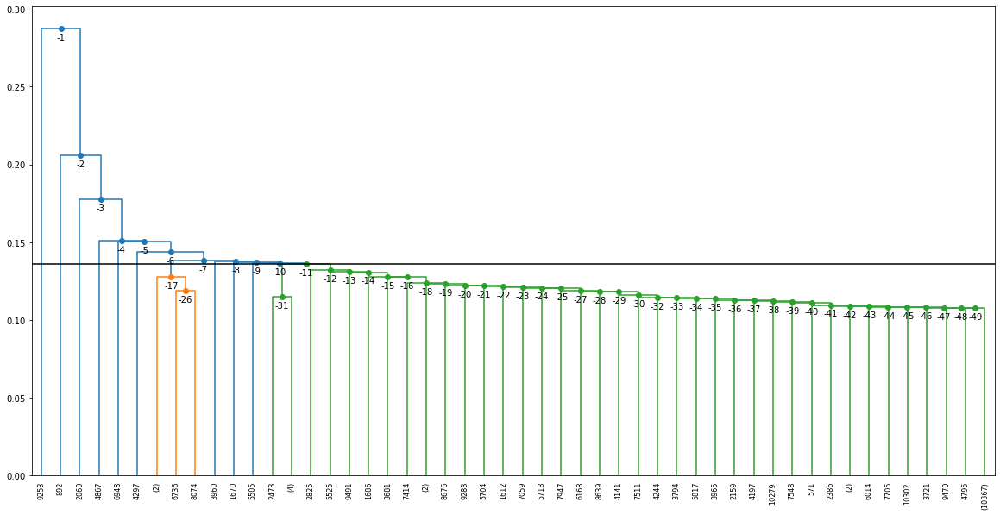

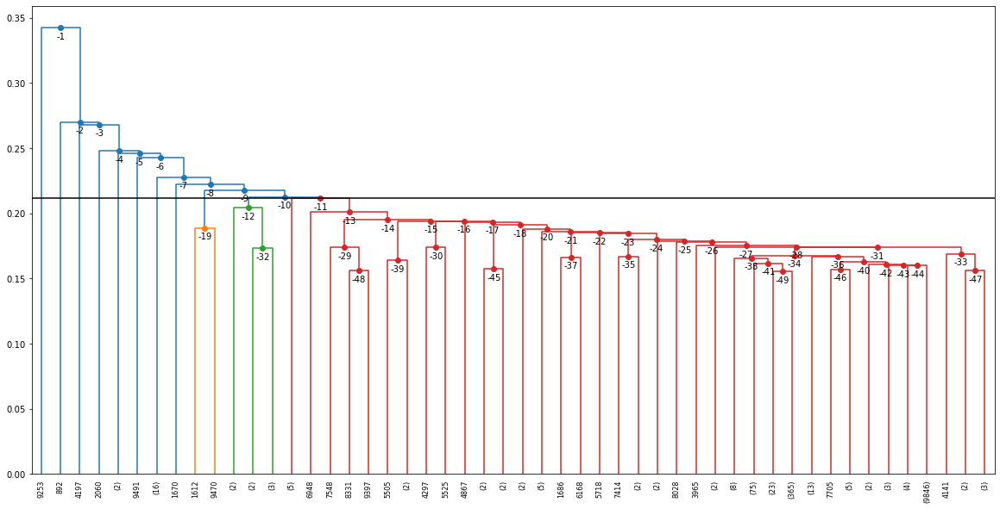

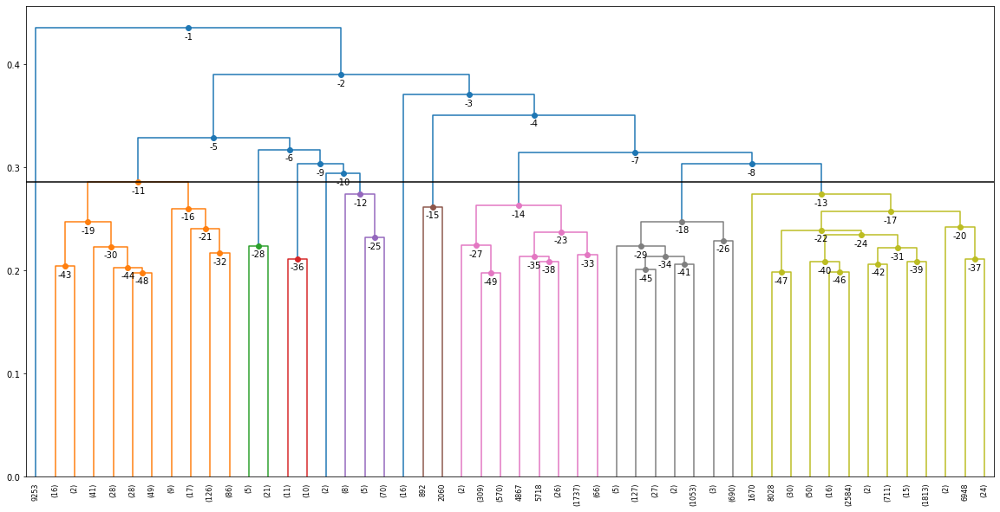

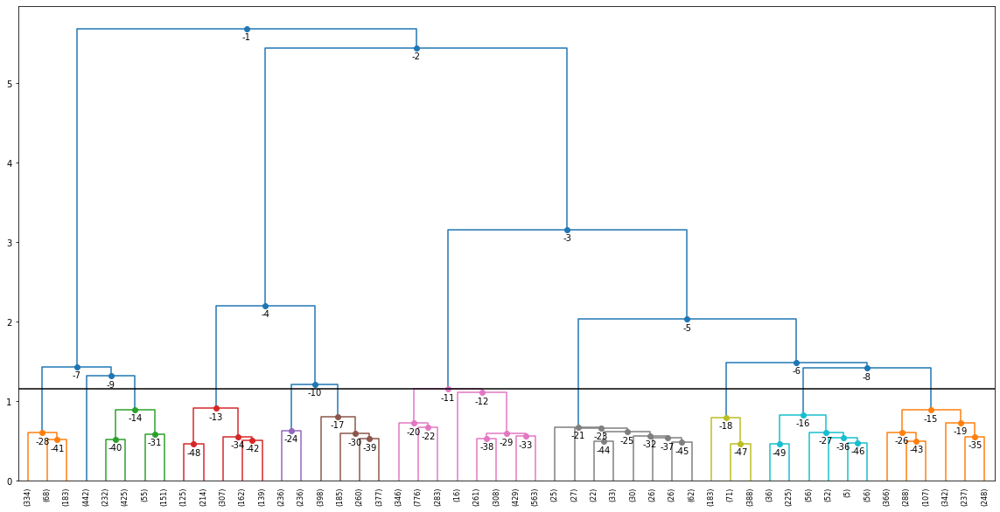

In [16]:
distance_threshold = None
n_clusters = 11
methods = ['single', 'average', 'complete','ward']
model_cluster = []            #Save the cluster with euclidean distance

for method in methods:
    model = AgglomerativeClustering(n_clusters = n_clusters, 
                                    distance_threshold = distance_threshold, 
                                    affinity = 'euclidean', linkage = method)

    y_predict = model.fit_predict(X_train)
    model_cluster.append(y_predict)

    plot_dendrogram(model = model, X = X_train, truncate_mode = 'lastp', p = 50, 
                    n_clusters = n_clusters, 
                    color_threshold = distance_threshold)

Another aspect that is taken into consideration is metrics used to compute the distance. What seems to be a good result is obtained with cosine similarity, again single and average linkage perform poorly while complete linkage give a good division for what is regarding the DNA type. We can see in fact that under the node -3 we have almost only genomic DNA.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

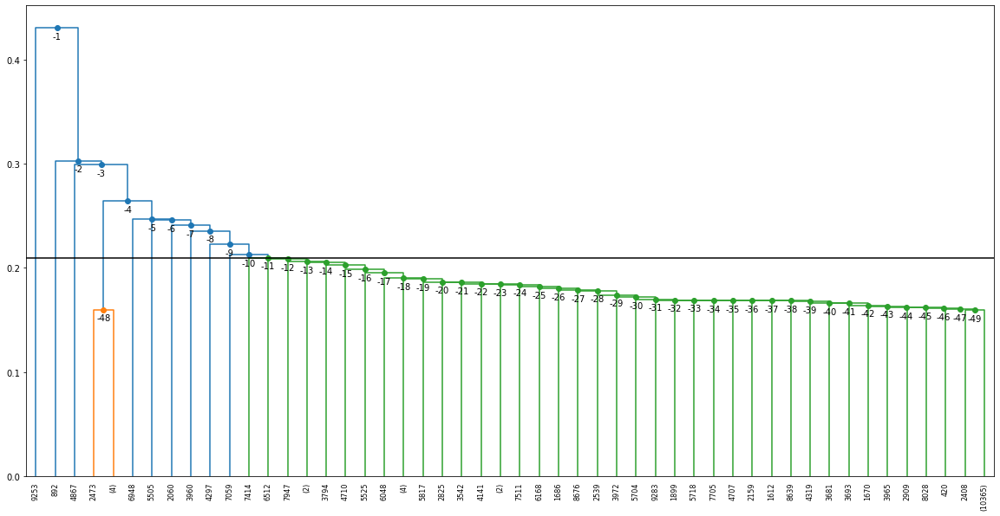

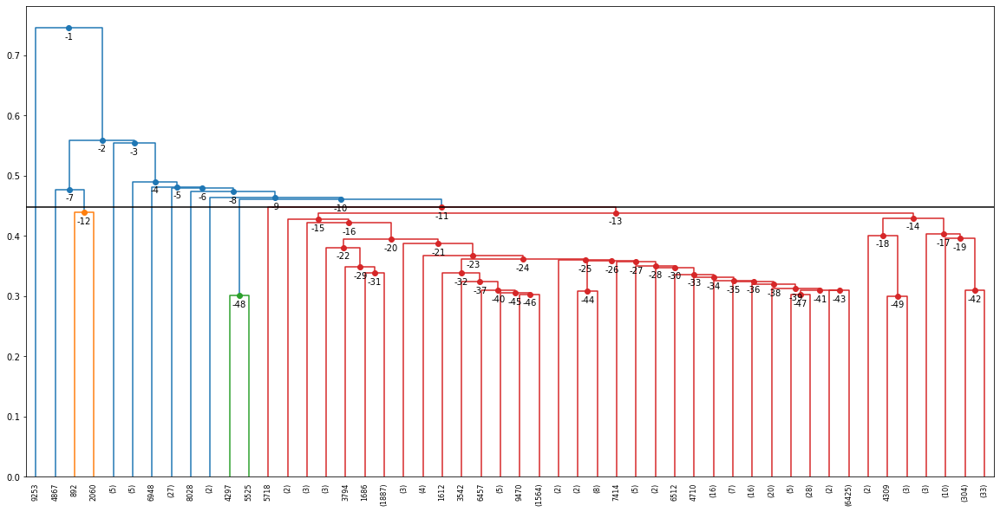

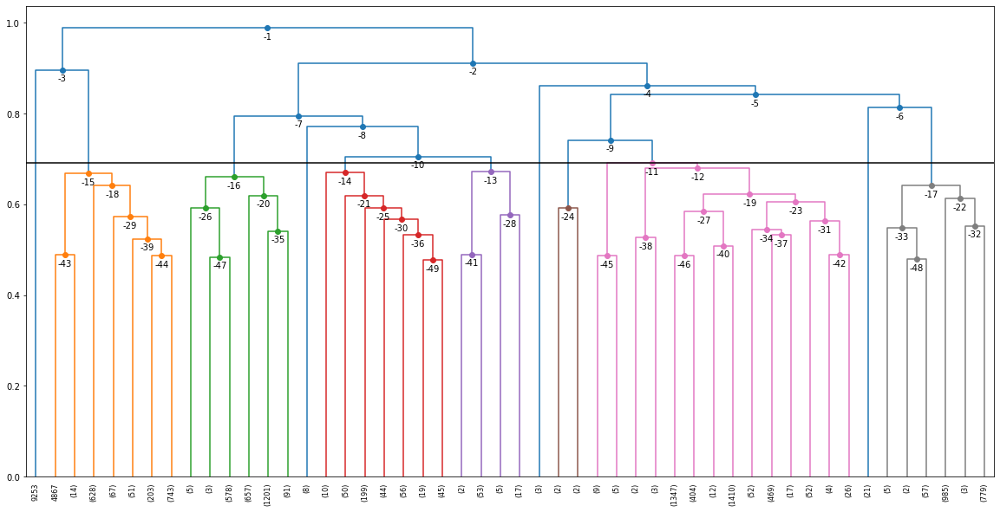

In [17]:
distance_threshold=None
n_clusters = 11
methods = ['single', 'average', 'complete']
model_cluster_cos = []                 #Save the model with cosine similarity as distance

for method in methods:
    model = AgglomerativeClustering(n_clusters = n_clusters, 
                                    distance_threshold = distance_threshold, 
                                    affinity = 'cosine', linkage = method)

    y_predict = model.fit_predict(X_train)
    model_cluster_cos.append(y_predict)

    plot_dendrogram(model = model, X = X_train, truncate_mode = 'lastp', p = 50, 
                    n_clusters = n_clusters, 
                    color_threshold = distance_threshold)

In [18]:
Z2 = linkage(X_train, metric = 'cosine', method = 'complete')   #New linkage matrix with cosine similarity

In [19]:
plot_node(Z2, X_train, train_DNA_type, -3)

               0  1  9
Frequency:  1706  1  1
Images in the cluster: 1708 / 10422


,1569,9700,2184,1201,9994,1518,1399,7323,1063,3333,...,10041,8515,3091,4431,1529,7914,3152,10416,1137,6974
UUU,0.01075,0.00725,0.01432,0.00994,0.04545,0.01320,0.03073,0.00602,0.01056,0.00000,...,0.01097,0.00169,0.00000,0.02405,0.00902,0.02415,0.00645,0.02105,0.00000,0.00235
UUC,0.03469,0.03769,0.02474,0.03258,0.03711,0.02186,0.05778,0.01279,0.02817,0.03669,...,0.02192,0.02679,0.02047,0.03230,0.02637,0.02778,0.02718,0.01203,0.02988,0.02647
UUA,0.00391,0.00000,0.00233,0.00179,0.00000,0.00495,0.00184,0.00150,0.00469,0.00000,...,0.00542,0.00418,0.00000,0.00069,0.00065,0.00483,0.00202,0.00050,0.00000,0.00294
UUG,0.01637,0.00290,0.01276,0.01466,0.00742,0.01485,0.01537,0.00150,0.01819,0.00222,...,0.01110,0.01440,0.00064,0.00825,0.00384,0.01218,0.01119,0.00351,0.00312,0.00941
CUU,0.01099,0.00174,0.01829,0.01645,0.00742,0.02144,0.00738,0.01354,0.01291,0.00056,...,0.01132,0.00652,0.00384,0.00619,0.01372,0.01255,0.00695,0.01203,0.00357,0.01765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAG,0.04251,0.04175,0.03284,0.04121,0.01948,0.02887,0.04302,0.08804,0.03991,0.05114,...,0.03870,0.04046,0.02943,0.01787,0.02055,0.03513,0.03491,0.04361,0.03434,0.03353
UAA,0.01735,0.02117,0.01857,0.03600,0.01391,0.02722,0.01414,0.00150,0.03110,0.00000,...,0.01075,0.01528,0.04862,0.01856,0.00837,0.02456,0.00773,0.01654,0.00000,0.00824
UAG,0.00000,0.00000,0.00055,0.00016,0.00000,0.00000,0.00000,0.00000,0.00059,0.00000,...,0.00057,0.00080,0.00000,0.00000,0.00018,0.00083,0.00040,0.00050,0.00000,0.00118
UGA,0.00098,0.00145,0.00173,0.00244,0.00093,0.00124,0.00123,0.00150,0.00235,0.00222,...,0.00110,0.00032,0.00448,0.00412,0.00118,0.00099,0.00221,0.00000,0.00491,0.00176


There are several way with which we can evaluate clustering. We can use both internal and external indexes, those evaluation are pretty complicated and they do not always give an optimal indication of the goodness of the clustering. Some of them are based on a visual inspection like the similarity matrix. With the following function we can compute both the incidence and similarity matrices as well as the correlation between the two.

In [20]:
def incidence_mat(y_pred):
    npoints = y_pred.shape[0]
    mat = np.zeros([npoints, npoints])
    # Retrieve how many different cluster ids there are
    clusters = np.unique(y_pred)
    nclusters = clusters.shape[0]
    
    for i in range(nclusters):
        sample_idx = np.where(y_pred == i)
        # Compute combinations of these indices
        idx = np.meshgrid(sample_idx, sample_idx)
        mat[idx[0].reshape(-1), idx[1].reshape(-1)] = 1
        
    return mat

def similarity_mat(X, metric):
    dist_mat = pairwise_distances(X, metric=metric)
    min_dist, max_dist = dist_mat.min(), dist_mat.max()
    
    # Normalize distances in [0, 1] and compute the similarity
    sim_mat = 1 - (dist_mat - min_dist) / (max_dist - min_dist)
    return sim_mat

def correlation(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    sim = similarity_mat(X, metric)
    
    # Note: we can eventually remove duplicate values
    # only the upper/lower triangular matrix
    # triuidx = np.triu_indices(y_pred.shape[0], k=1)
    # inc = inc[triuidx]
    # sim = sim[triuidx]
    
    inc = normalize(inc.reshape(1, -1))
    sim = normalize(sim.reshape(1, -1))
    corr = (inc @ sim.T)
    return corr[0,0]   

In [21]:
def sorted_sim(sim, y_pred):
    idx_sorted = np.argsort(y_pred)
    # Sort the rows
    sim = sim[idx_sorted]
    # Sort the columns
    sim = sim[:, idx_sorted]
    
    return sim

def plot_sorted_mat(sim, y_pred):
    sim = sorted_sim(sim, y_pred)
    
    fig, ax = plt.subplots(figsize=(40,30))  
    ax = sns.heatmap(sim, ax=ax)
    # Remove ruler (ticks)
    ax.set_yticks([]) 
    ax.set_xticks([])

(10422,)

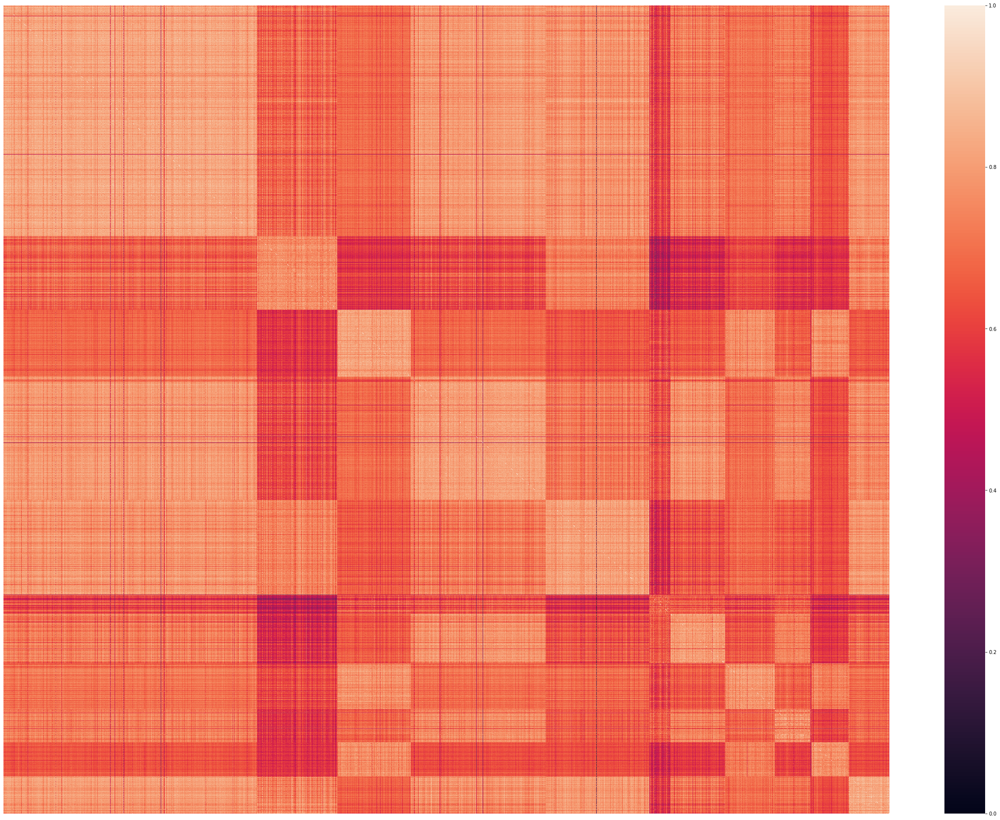

In [22]:
sim = similarity_mat(X_train, 'euclidean')            #Building the similarity matrix
model_cluster[3].shape
plot_sorted_mat(sim, model_cluster[3])                #Plot the matrix related to the model with ward linkage and euclidean distance

In those plot we can have a visual inspection of the similarity matrix, ideally we should have 11 squares on the diagonal with high similarity. However, this is not the case suggesting a low correlation between the two matrices.

A different way in order to try to evaluate clustering is make use of internal indexes, so indexes that does not use any external information. One example of those is given by the measure of the cohesion and separation within the clustering. Cohesion is measured using the within sum of squares (WSS) while separation is given by the between sum of squares (BSS). The problem of those metrics is that, since they do not rely on external information, they can be biased due to the wrong choice of the distance that we have used.

In [23]:
def wss(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    
    dist_mat = pairwise_distances(X, metric=metric)
    dist_mat = dist_mat * inc
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    return (dist_mat[triu_idx] ** 2).sum()

def bss(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    not_inc = 1 - inc
    
    dist_mat = pairwise_distances(X, metric=metric)
    dist_mat = dist_mat * not_inc
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    return (dist_mat[triu_idx] ** 2).sum()

In a good clustering we would like to have a low WSS and a high BSS, so maximize the distance between the clusters and minimize the distance within points in the same cluster. We can see that we have good results using complete and ward linkage as previously mentioned. Another interesting aspect is that, as we can see, the sum of WSS and BSS is always constant.

In [24]:
print("Single linkage WSS:", wss(X_train, model_cluster[0], 'euclidean'))       #single linkage
print("Single linkage BSS:", bss(X_train, model_cluster[0], 'euclidean'))
print("Average linkage WSS", wss(X_train, model_cluster[1], 'euclidean'))       #average linkage
print("Average linkage BSS", bss(X_train, model_cluster[1], 'euclidean'))
print("Complete linkage WSS:", wss(X_train, model_cluster[2], 'euclidean'))       #complete linkage
print("Complete linkage BSS:", bss(X_train, model_cluster[2], 'euclidean'))
print("Ward linkage WSS:", wss(X_train, model_cluster[3], 'euclidean'))       #ward linkage
print("Ward linkage BSS", bss(X_train, model_cluster[3], 'euclidean'))


Single linkage WSS: 945333.0120245282
Single linkage BSS: 7070.100320346078
Average linkage WSS 933437.0206452926
Average linkage BSS 18966.091699586177
Complete linkage WSS: 185674.2854417494
Complete linkage BSS: 766728.826903125
Ward linkage WSS: 63674.43509506104
Ward linkage BSS 888728.677249818


We can do the same with clustering done using cosine similarity, however it is difficult to make a comparison between the two. Even in this we can see how complete linkage is significantly better.

In [25]:
print("Single linkage WSS:", wss(X_train, model_cluster_cos[0], 'cosine'))        #single
print("Single linkage BSS:", bss(X_train, model_cluster_cos[0], 'cosine'))
print("Average linkage WSS", wss(X_train, model_cluster_cos[1], 'cosine'))       #average
print("Average linkage BSS", bss(X_train, model_cluster_cos[1], 'cosine'))
print("Complete linkage WSS:", wss(X_train, model_cluster_cos[2], 'cosine'))        #complete
print("Complete linkage BSS:", bss(X_train, model_cluster_cos[2], 'cosine'))

Single linkage WSS: 6111633.035362242
Single linkage BSS: 41261.15495389526
Average linkage WSS 6022977.065549303
Average linkage BSS 129917.12476682091
Complete linkage WSS: 444755.3724437553
Complete linkage BSS: 5708138.817872362


In order to visualize those results in a clear way we plot them in the case of euclidean distance and ward linkage. WSS and BSS are calculated for different number of clusters giving different results, this computation sometimes can be used to estimate the number of clusters, this technique is called elbow method. Another index that we can use is the silhouette index which combine both the WSS and BSS. From the results we can see that an increasing number of clusters seems to reduce WSS and increase BSS, this is normal in fact if we imagine to have one cluster per point then WSS will be 0 and BSS maximum. The graph suggested that 3 can be the ideal number of clusters and this make sense because we have only 3 class in the DNA type classification. The silhouette score instead decrease with more clusters suggesting that a lower number of clusters should be better.

1
2
3
4
5
6
7
8
9
10
11
12
13
14


Text(0.5, 0, 'Number of clusters')

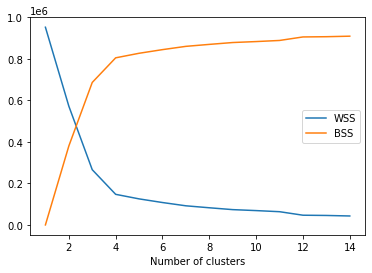

Text(0.5, 0, 'Number of clusters')

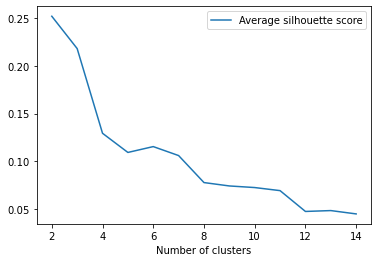

In [26]:
wss_list, bss_list, sil_list = [], [], []
clus_list = list(range(1, 15))

for nc in clus_list:
    model = AgglomerativeClustering(n_clusters = nc,
                                    affinity = 'euclidean', 
                                    linkage = 'ward')

    y_predict = model.fit_predict(X_train)
    
    wss_list.append(wss(X_train, y_predict, 'euclidean'))
    bss_list.append(bss(X_train, y_predict, 'euclidean'))
    if nc > 1:
        sil_list.append(silhouette_score(X_train, y_predict, metric = 'euclidean'))
    print(nc)
    
plt.plot(clus_list, wss_list, label = 'WSS')
plt.plot(clus_list, bss_list, label = 'BSS')
plt.xlabel("Number of clusters")
plt.legend()
plt.show()

plt.plot(clus_list[1:], sil_list, label = 'Average silhouette score')
plt.xlabel("Number of clusters")
plt.legend()

Finally we can see the performance using only 3 clusters.

(<Figure size 1440x720 with 1 Axes>, <AxesSubplot:>)

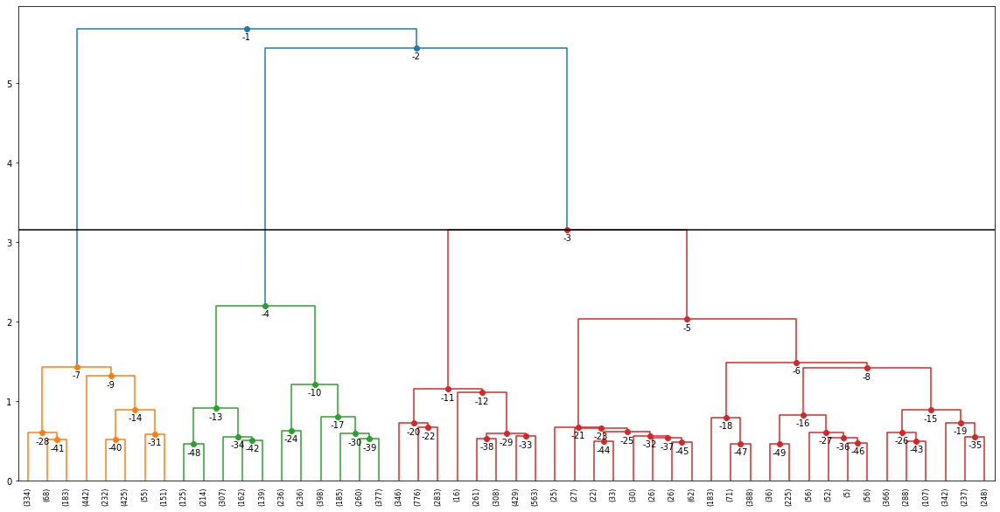

In [27]:
final_model = AgglomerativeClustering(n_clusters = 3, 
                                    distance_threshold = distance_threshold, 
                                    affinity = 'euclidean', linkage = 'ward')

y_predict_final = final_model.fit_predict(X_train)
    

plot_dendrogram(model = final_model, X = X_train, truncate_mode = 'lastp', p = 50, 
                n_clusters = 3, 
                color_threshold = distance_threshold)

The similarity matrix is stil pretty noisy but we can distinguish the 3 big squares on the diagonal which are a bit more correlated than the others.

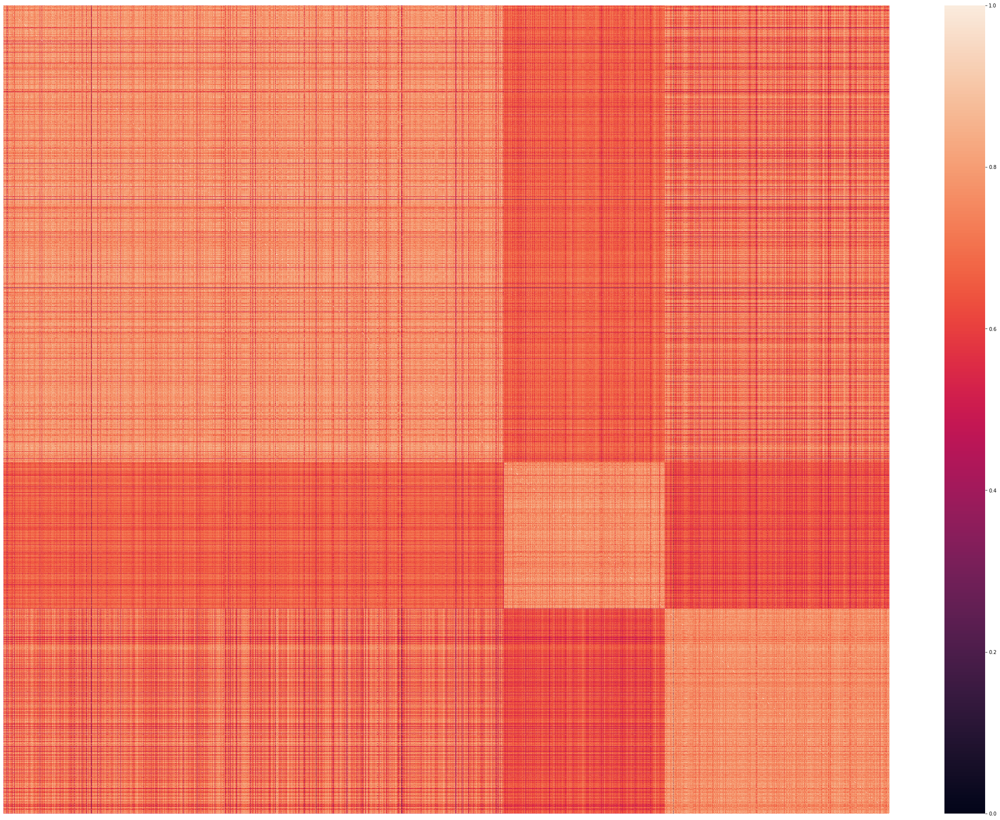

In [28]:
sim = similarity_mat(X_train, 'euclidean')            #Building the similarity matrix
plot_sorted_mat(sim, y_predict_final)                #Plot the matrix related to the model with ward linkage and euclidean distance

Finally we look at the distribution of the points using both 3 and 11 clusters. If they are good clusters we should see a distribution fairly similar to the one in the data. This is partially true fo the agglomerative clusterig cut ad 3 cluster. Even in the case of 11 cluster we can see how it resembles the 11 kingdoms that we have.

<Figure size 720x576 with 0 Axes>

<AxesSubplot:ylabel='count'>

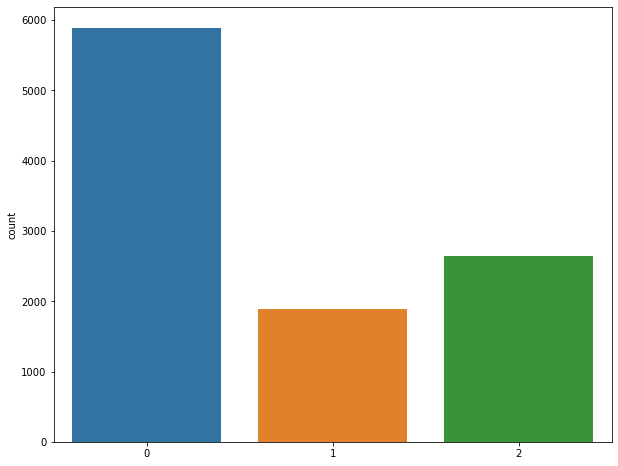

In [29]:
plt.figure(figsize = (10,8))
sns.countplot(x = y_predict_final)

<Figure size 720x576 with 0 Axes>

<AxesSubplot:ylabel='count'>

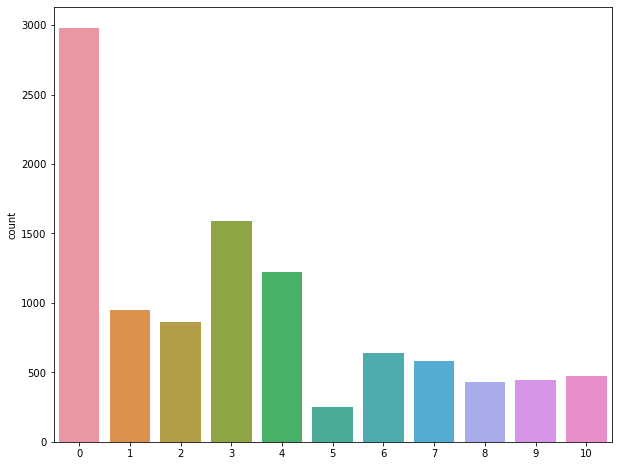

In [30]:
plt.figure(figsize = (10,8))
sns.countplot(x = model_cluster[3])

Now that we have evaluate our algorithms using internal indexes we can use external indexes too, since we have a classification for our samples. Those function are used to compute the precision and recall of our clusters based on one of the two classification avaiable. 

In [31]:
def get_Ncounts(y_predict, y_true, k, j=None):
    N = y_true.shape[0]
    Nk_mask = y_predict == k
    Nk = Nk_mask.sum()
    Nj, Nkj = None, None
    if j is not None:
        Nj_mask = y_true == j
        Nj = Nj_mask.sum()
        Nkj = np.logical_and(Nj_mask, Nk_mask).sum()
    return N, Nk, Nj, Nkj

def precision(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nk + 1e-8)
    
def recall(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nj + 1e-8)

def F(y_predict, y_true, k, j):
    p = precision(y_predict, y_true, k, j)
    r = recall(y_predict, y_true, k, j)
    return (2*p*r) / (p+r)

def purity(y_predict, y_true, k):
    cls = np.unique(y_true)
    prec = [precision(y_predict, y_true, k, j) for j in cls]
    return max(prec)

def tot_purity(y_predict, y_true):
    N = y_true.shape[0]
    nc = len(np.unique(y_true))
    p = 0
    for k in range(nc):
        N, Nk, _, _ = get_Ncounts(y_predict, y_true, k)
        pk = purity(y_predict, y_true, k)
        p += (Nk / N) * pk
    return p

### Partitive clustering

Other than hierarchical clustering we can also try partitive algorithms such as k-means. In those type of algortihms the difference is that the number of cluster is defined a priori. In our case we have 2 possible options, the first one is consider the 11 kingdoms and the second one is to consider the 3 main DNA type. It is also important to remember that for this particular algorithm the inizialization step is very important, which means that for the first iteration the centroids should be disposed in a meaningful way. We wil consider two possible inizialization methods.

In [32]:
model = KMeans(n_clusters = 11, init = 'random', random_state = 0)             
y_predict = model.fit_predict(X_train)
purity_rand_11 = tot_purity(model.fit_predict(X_train), train_kingdom)
print("Random inizialization with 11 cluster purity:", purity_rand_11)

model = KMeans(n_clusters = 11, init = 'k-means++', random_state = 0)             
y_predict = model.fit_predict(X_train)
purity_k_11 = tot_purity(model.fit_predict(X_train), train_kingdom)
print("Kmeans++ inizialization with 11 cluster purity:", purity_k_11)

model = KMeans(n_clusters = 3, init = 'random', random_state = 0)             
y_predict = model.fit_predict(X_train)
purity_rand_3 = tot_purity(model.fit_predict(X_train), train_DNA_type)
print("Random inizialization with 3 cluster purity:", purity_rand_3)

model = KMeans(n_clusters = 3, init = 'k-means++', random_state = 0)             
y_predict = model.fit_predict(X_train)
purity_k_3 = tot_purity(model.fit_predict(X_train), train_DNA_type)
print("Kmeans++ inizialization with 3 cluster purity:", purity_rand_3)

Random inizialization with 11 cluster purity: 0.576089042403429
Kmeans++ inizialization with 11 cluster purity: 0.5747457301792923
Random inizialization with 3 cluster purity: 0.8926309729391831
Kmeans++ inizialization with 3 cluster purity: 0.8926309729391831


Finally in order to try to compare those different algorithms we compute the purity for all of the hierachical clustering seen before. We can see that the purity when we consider the kingdom classification is lower than the one with respect to DNA type; this is true both for k-means and hierarchical clustering. In the end we can conclude that with 3 cluster we can obtain pretty good results both with hierarchical clustering and k-means.

1
2
3
4
5
6
7
8
9
10
11
12
13
14


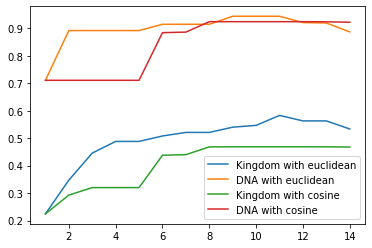

In [33]:
tot_pur_king_eu = []
tot_pur_DNA_eu = []
tot_pur_king_cos = []
tot_pur_DNA_cos = []

clus_list = list(range(1, 15))

for nc in clus_list:
    model_eu = AgglomerativeClustering(n_clusters=nc,
                                    affinity='euclidean', 
                                    linkage='ward')
    
    model_cos = AgglomerativeClustering(n_clusters=nc,
                                    affinity='cosine', 
                                    linkage='complete')
    

    

    y_predict_eu = model_eu.fit_predict(X_train)
    y_predict_cos = model_cos.fit_predict(X_train)
    
    tot_pur_king_eu.append(tot_purity(y_predict_eu, train_kingdom))
    tot_pur_DNA_eu.append(tot_purity(y_predict_eu, train_DNA_type))
    
    tot_pur_king_cos.append(tot_purity(y_predict_cos, train_kingdom))
    tot_pur_DNA_cos.append(tot_purity(y_predict_cos, train_DNA_type))

    print(nc)
    
plt.plot(clus_list, tot_pur_king_eu, label='Kingdom with euclidean')
plt.plot(clus_list, tot_pur_DNA_eu, label='DNA with euclidean')
plt.plot(clus_list, tot_pur_king_cos, label='Kingdom with cosine')
plt.plot(clus_list, tot_pur_DNA_cos, label='DNA with cosine')
plt.legend()
plt.show()

As last thing we try to see if reducing the number of variables that we use can improve purity of the clustering. The results that we get are pretty much identical.

In [34]:
# Define PCA with 3 components, this will transform 
pca = PCA(n_components = 25)

X_train_PCA = pca.fit_transform(X_train)
pd.DataFrame(X_train_PCA)

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,-0.010929,-0.018486,-0.012932,-0.010004,-0.011811,-0.018353,-0.000688,-0.000662,0.003061,0.010127,...,0.018022,0.008145,0.001826,-0.000157,-0.000218,0.009606,0.003520,0.012239,0.010478,0.000282
1,0.042111,-0.019906,-0.028713,-0.008086,0.000006,-0.004150,0.007602,-0.006670,-0.011028,-0.017654,...,-0.014001,0.006979,-0.004417,0.012548,0.014914,-0.001023,-0.003125,0.012788,0.000259,-0.005826
2,-0.044010,-0.037372,-0.006153,0.030880,0.004191,-0.009911,0.018231,0.010332,-0.018049,-0.001681,...,-0.011054,0.000565,0.008523,-0.000733,0.000312,0.004594,-0.013240,-0.004717,-0.002322,0.007073
3,0.025055,-0.020870,0.009238,0.017731,0.008232,-0.007505,-0.000840,0.000538,0.012025,-0.006101,...,0.007854,-0.005623,0.002419,0.000209,-0.001467,0.000104,0.010567,-0.002537,-0.001205,0.003369
4,-0.028364,0.068069,0.000382,-0.003985,0.031920,-0.002876,0.008280,-0.022405,0.011099,0.014162,...,-0.016874,0.005877,-0.002865,0.011290,0.013215,0.002945,-0.003365,0.003782,-0.008554,0.014698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,0.023231,-0.014628,-0.009719,-0.015427,0.000646,-0.001916,-0.017216,0.005946,-0.004323,0.009211,...,0.004419,-0.007955,0.000678,-0.004563,-0.010148,0.003235,0.004499,-0.009939,-0.000518,-0.010298
10418,0.016178,-0.009388,-0.013080,-0.001469,-0.016381,-0.008751,-0.006073,0.000784,-0.001223,0.018214,...,0.000445,-0.003230,0.000401,-0.008889,-0.001468,0.005592,0.000430,-0.010731,-0.002454,0.000899
10419,0.075831,0.000039,0.030306,0.017849,0.005142,0.007659,0.008164,-0.013393,0.000244,0.003206,...,0.004214,-0.011814,-0.004800,0.008000,-0.003372,-0.010665,0.017661,0.002687,0.004192,0.005941
10420,-0.059858,-0.033861,0.021011,-0.006517,-0.010245,0.046538,-0.015217,0.008187,0.001464,-0.012483,...,0.034355,0.012199,-0.005237,0.011019,-0.006338,-0.000211,0.006477,-0.000576,0.003911,-0.001236


1
2
3
4
5
6
7
8
9
10
11
12
13
14


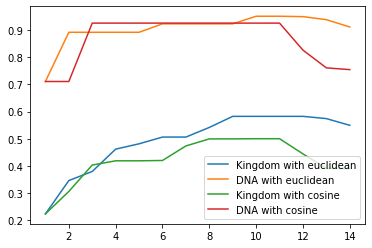

In [35]:
tot_pur_king_eu_PCA = []
tot_pur_DNA_eu_PCA = []
tot_pur_king_cos_PCA = []
tot_pur_DNA_cos_PCA = []

clus_list = list(range(1, 15))

for nc in clus_list:
    model_eu_PCA = AgglomerativeClustering(n_clusters=nc,
                                    affinity='euclidean', 
                                    linkage='ward')
    
    model_cos_PCA = AgglomerativeClustering(n_clusters=nc,
                                    affinity='cosine', 
                                    linkage='complete')
    

    

    y_predict_eu_PCA = model_eu_PCA.fit_predict(X_train_PCA)
    y_predict_cos_PCA = model_cos_PCA.fit_predict(X_train_PCA)
    
    tot_pur_king_eu_PCA.append(tot_purity(y_predict_eu_PCA, train_kingdom))
    tot_pur_DNA_eu_PCA.append(tot_purity(y_predict_eu_PCA, train_DNA_type))
    
    tot_pur_king_cos_PCA.append(tot_purity(y_predict_cos_PCA, train_kingdom))
    tot_pur_DNA_cos_PCA.append(tot_purity(y_predict_cos_PCA, train_DNA_type))

    print(nc)
    
plt.plot(clus_list, tot_pur_king_eu_PCA, label='Kingdom with euclidean')
plt.plot(clus_list, tot_pur_DNA_eu_PCA, label='DNA with euclidean')
plt.plot(clus_list, tot_pur_king_cos_PCA, label='Kingdom with cosine')
plt.plot(clus_list, tot_pur_DNA_cos_PCA, label='DNA with cosine')
plt.legend()
plt.show()

# Classification

The second point is try to find a classification algorithm such that we can predict other organisms. We already have a train set that we can use in order to train our algorithms and a test set to evaluate the performance. In order to have a better idea of the accuracy of our models we will further divide our train set in 2 pieces, so we will have a train set and a validation set. In this way we will be able to perform cross validation and a have a more robust evaluation of the performance of our algorithm. We have to remember that, since we are going to train our model with less records, we expect that our performance on the test set will be slightly better.

The first thing that we have to do is to remove the 'AGA' and 'ACA' features because they are not present in the test set.

In [36]:
X_class = X_train.drop(['AGA', 'ACA'], axis = 1)
X_class

,UUU,UUC,UUA,UUG,CUU,CUC,CUA,CUG,AUU,AUC,...,CGA,CGG,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA
0,0.01541,0.00927,0.01720,0.01825,0.01436,0.02303,0.01555,0.02094,0.01885,0.01226,...,0.00853,0.00643,0.01182,0.02812,0.00838,0.03365,0.01974,0.01511,0.00030,0.00030
1,0.01213,0.02515,0.00268,0.01352,0.01372,0.01143,0.00775,0.02992,0.01352,0.03370,...,0.00378,0.00268,0.01412,0.03280,0.02555,0.03708,0.05398,0.03330,0.00030,0.00050
2,0.02580,0.01618,0.03606,0.01354,0.00848,0.02067,0.01041,0.00278,0.03250,0.01768,...,0.00570,0.00114,0.00499,0.03756,0.02523,0.05388,0.01946,0.02245,0.00121,0.00086
3,0.00128,0.02141,0.01225,0.01649,0.01330,0.01308,0.00399,0.02834,0.02508,0.02611,...,0.00359,0.01177,0.00422,0.03316,0.02229,0.03444,0.02370,0.00831,0.00028,0.00063
4,0.03169,0.01780,0.03893,0.00000,0.06240,0.01056,0.05262,0.01408,0.03873,0.03873,...,0.01056,0.00000,0.00000,0.00020,0.01389,0.02465,0.00352,0.00352,0.00000,0.02465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,0.02289,0.02959,0.00614,0.02680,0.01452,0.02178,0.00558,0.01228,0.02401,0.01954,...,0.00279,0.00558,0.01173,0.03071,0.01954,0.01787,0.02848,0.03127,0.00112,0.00000
10418,0.02532,0.01557,0.00878,0.01185,0.01160,0.02654,0.00979,0.02313,0.01773,0.01977,...,0.00791,0.00477,0.01008,0.02070,0.00726,0.02388,0.02233,0.01814,0.00025,0.00038
10419,0.01614,0.02618,0.00131,0.01003,0.02661,0.01658,0.00218,0.04712,0.01920,0.03054,...,0.00262,0.01702,0.00567,0.02487,0.00000,0.02661,0.02618,0.01353,0.00000,0.00349
10420,0.00196,0.01761,0.04501,0.03131,0.02544,0.00978,0.01761,0.00783,0.04305,0.00587,...,0.01761,0.00391,0.00391,0.02348,0.01957,0.03523,0.00978,0.00196,0.00000,0.00196


## Logistic Regression

The first classifier that we are going to consider is the logistic regression. It is one of the most easy algorithms to understand because it is very easy to understand the meaning of the parameters, and consequently the interpretation of the model and the relative variables. This huge advantage in interpretability however is lost in terms of pure performance, this is related to the bias and variance trade-off. In particular this algorithm try to model the probability of the class given the input. 

Since our dataset in pretty big, some models may be time consuming to be trained. This is true both because we have many records and both because we have many features. The solution is try to reduce both of them when is necessary. In order to reduce the number of features, that in our case is 62, we have 3 possible options: feature selection, shrinkage methods and dimensionality reduction. The first one is feature selection: this method can be executed in different ways, we have the best subset selection which finds the best subset of features, wich give the higher accuracy and the stepwise (forward or backward) selection. Best subset selection in our case is infeasible since we would have too many models to train. Stepwise forward selection is an efficient alternatie that does not yield the best possible solution, it is less time and memory consuming but not that fast. 

In fact, given the number of features we have we would have to train more than 2000 models. In order to reduce the amount of time needed we can take a random sample of our 10000 records and use this random sample for the feature selection. To chose the right number of samples we will have to do a trade-off between time and accuray.

In [37]:
warnings.filterwarnings('ignore')
number_of_records = [100, 300, 500, 700, 1000, 1500, 2000, 3000, 5000, 7500, 10000]       #Number of records considered
duration = []
score = []

for i in number_of_records:
    
    print(f'This is the model trained with {i} samples')
    
    start = time.time()          #Time measure
    
    train_data_class = train_data.sample(n = i)               #selection of the random sample
    X_class_small = train_data_class.iloc[:,6::]
    X_class_small = X_class_small.drop('AGA', axis=1)
    train_kingdom_small = train_data_class.iloc[:,1]
    
    train_kingdom_enc_small = pd.DataFrame(train_kingdom_small)      
    ord_enc = OrdinalEncoder()                               #The 11 classes are encoded in numbers
    train_kingdom_enc_small["Kingdom_code"] = ord_enc.fit_transform(train_kingdom_enc_small[["Kingdom"]])
    
    #Cross validation, the function cross_val_score automatically divide in train and validation set
    score.append(np.mean(cross_val_score(LogisticRegression(solver="newton-cg", penalty='none', multi_class = 'ovr'),
                        X_class_small, train_kingdom_enc_small.iloc[:,1], cv = 5)))     
    
    end = time.time()
    
    iteration_time = end - start
    
    duration.append(iteration_time)

This is the model trained with 100 samples
This is the model trained with 300 samples
This is the model trained with 500 samples
This is the model trained with 700 samples
This is the model trained with 1000 samples
This is the model trained with 1500 samples
This is the model trained with 2000 samples
This is the model trained with 3000 samples
This is the model trained with 5000 samples
This is the model trained with 7500 samples
This is the model trained with 10000 samples


After have trained the same model with a different number of samples we can visualize the results in those plot. It was easy to imagine that the higher the number of points the higher would be the overall accuracy. However models with more than 3000 samples are very long to train, a complete model with all the features and points takes more than 20 seconds. If we want to do feature selection in an efficient way we may try with 1500 points. From the plot we can see that they still keep a significant accuracy. Once we have done feature selection we can increase again the number of samples for that specific model.

<AxesSubplot:>

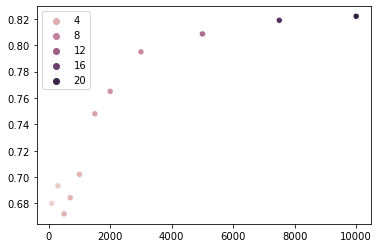

In [38]:
sns.scatterplot(x = number_of_records, y = score, hue = duration)

In [39]:
train_data_class = train_data.sample(n = 1500)       #We select the random sample from the whole dataset
X_class_small = train_data_class.iloc[:,6::]
X_class_small = X_class_small.drop(['AGA', 'ACA'], axis=1)
X_class_small
train_kingdom_small = train_data_class.iloc[:,1]     #The same random sample should be extracted from the kingdom classification
train_kingdom_small

,UUU,UUC,UUA,UUG,CUU,CUC,CUA,CUG,AUU,AUC,...,CGA,CGG,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA
9324,0.00283,0.00636,0.09187,0.03604,0.01272,0.00035,0.00883,0.00424,0.04700,0.00495,...,0.00318,0.00035,0.01201,0.01590,0.00353,0.01131,0.01272,0.00071,0.00318,0.01590
1289,0.00597,0.04007,0.01535,0.00171,0.00597,0.04348,0.08696,0.01279,0.01961,0.04945,...,0.01023,0.00085,0.00085,0.00426,0.00512,0.03069,0.00171,0.01364,0.00085,0.02217
6063,0.01298,0.02931,0.00251,0.01340,0.00670,0.02261,0.00503,0.03643,0.01256,0.03811,...,0.00293,0.00628,0.00419,0.02052,0.00712,0.04439,0.03518,0.01131,0.00042,0.00126
4232,0.00578,0.02921,0.00030,0.02008,0.00487,0.00974,0.00213,0.07393,0.01095,0.04229,...,0.00243,0.00913,0.00122,0.01765,0.04077,0.03073,0.02434,0.03316,0.00061,0.00183
6514,0.00396,0.01386,0.11551,0.00132,0.01980,0.00132,0.01980,0.00066,0.11353,0.01386,...,0.00726,0.00000,0.00066,0.01056,0.00330,0.01782,0.00000,0.00000,0.00066,0.02508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1764,0.00511,0.01340,0.03875,0.01099,0.02117,0.02774,0.01276,0.00458,0.05019,0.01740,...,0.00590,0.00290,0.00144,0.03995,0.02472,0.06185,0.01289,0.00709,0.00042,0.00060
3553,0.02174,0.02227,0.00053,0.01060,0.01538,0.00159,0.00583,0.01432,0.01432,0.02545,...,0.01591,0.00053,0.00212,0.02704,0.02545,0.01591,0.04401,0.01273,0.00000,0.00106
4853,0.02257,0.02461,0.00356,0.01027,0.00651,0.03915,0.00691,0.04342,0.01119,0.02837,...,0.00295,0.00529,0.01332,0.01495,0.01719,0.01668,0.04342,0.00153,0.00031,0.00092
5169,0.00608,0.03467,0.05434,0.00906,0.03286,0.01850,0.03545,0.01035,0.05732,0.04114,...,0.00802,0.00104,0.00026,0.01009,0.02704,0.01669,0.00543,0.00323,0.00039,0.02057


9324    inv
1289    vrt
6063    bct
4232    bct
6514    inv
       ... 
1764    bct
3553    pln
4853    vrt
5169    vrt
6768    pln
Name: Kingdom, Length: 1500, dtype: object

Both the small and the complete kingdom columns are encoded in numbers.

In [40]:
train_kingdom_enc = pd.DataFrame(train_kingdom)
train_kingdom_enc_small = pd.DataFrame(train_kingdom_small)
test_kingdom_enc = pd.DataFrame(test_kingdom)

ord_enc = OrdinalEncoder()
train_kingdom_enc["Kingdom_code"] = ord_enc.fit_transform(train_kingdom_enc[["Kingdom"]])
train_kingdom_enc_small["Kingdom_code"] = ord_enc.fit_transform(train_kingdom_enc_small[["Kingdom"]])
train_kingdom_enc.head()
test_kingdom_enc["Kingdom_code"] = ord_enc.fit_transform(test_kingdom_enc[["Kingdom"]])
test_kingdom_enc.head()

,Kingdom,Kingdom_code
0,vrl,9.0
1,inv,2.0
2,bct,1.0
3,bct,1.0
4,vrt,10.0


,Kingdom,Kingdom_code
0,bct,1.0
1,inv,2.0
2,pln,6.0
3,pln,6.0
4,pln,6.0


In [41]:
king = np.unique(train_kingdom_enc.iloc[:,0])
code_king = np.unique(train_kingdom_enc.iloc[:,1])
king_dict = pd.DataFrame(king, code_king)
king_dict

,0
0.0,arc
1.0,bct
2.0,inv
3.0,mam
4.0,phg
5.0,plm
6.0,pln
7.0,pri
8.0,rod
9.0,vrl


The results of all the trained models will be stored in this variable.

In [42]:
results = pd.DataFrame(columns = ['Model', 'Validation score'])

Before starting with feature selection we take a look at the performance of a simple Logistic Regression model, which include all the data avaiable, using cross validation.

In [43]:
simple_Log = LogisticRegression(solver = "newton-cg", penalty = 'none', multi_class = 'ovr')

score_simple_Log = cross_val_score(simple_Log, X_class, train_kingdom_enc.iloc[:,1], cv = 5)

results = results.append({'Model':'Simple Logistic Regression', 'Validation score':np.mean(score_simple_Log)}, ignore_index = True)
print(f'The score of the 5 validation set is: {score_simple_Log}')
print(f'The average score is {np.mean(score_simple_Log)}')

The score of the 5 validation set is: [0.82589928 0.81630695 0.81909789 0.81285988 0.82245681]
The average score is 0.8193241644688088


Now we can start with forward selection. The algorithm will return us the result of all the best models for every number of features as well as the best model overall.

In [44]:
def accuracy(y_pred, y_true):
    return (y_pred == y_true).sum() / y_pred.shape[0]

def get_evaluator(scorer):
    def evaluator(model, X, y, trained=False):
        if not trained:
            model = model.fit(X, y)
        score = scorer(model, X, y)
        return model, score
    return evaluator   

def get_cv_evaluator(scorer, cv=3):
    def evaluator(model, X, y, trained=False):            
        scores = cross_val_score(model, X, y, scoring=scorer, cv=cv)
        if not trained:
            model = model.fit(X, y)
        return model, np.mean(scores)
    
    return evaluator

def get_val_evaluator(scorer, val_size=0.1):
    def evaluator(model, X, y, trained=False):
        X_train_small, X_val, y_train_small, y_val = train_test_split(X, y, 
                                                                      test_size=val_size,
                                                                      random_state=0)
        
        if not trained:
            model = model.fit(X_train_small, y_train_small)
        score = scorer(model, X_val, y_val) 
        
        return model, score
    
    return evaluator

def forward_selection(Xtrain_pd, ytrain, Xtest_pd, ytest, classifier,
                      candidates_evaluator, candidates_argbest, # Metric to be used at 2.b
                      subsets_evaluator, subsets_argbest,      # Metric to be used at 3
                      test_evaluator=None, test_argbest=None,
                      candidates_scorer_name=None,  # Name of 2. figure
                      subsets_scorer_name=None,     # Name of 3. figure
                      verbose=True, weight_step3=0):   
    test_evaluator = subsets_evaluator if not test_evaluator else test_evaluator
    test_argbest = subsets_argbest if not test_argbest else test_argbest
    
    # Global variable init
    # ====================
    num_features = Xtrain_pd.shape[-1]
    best_candidate_metric = []
    # subsets_* are lists containing one value for each Mk model (the best of the Mk candidates)
    subsets_test = []
    subsets_metric = []        # The best metric of each subset of dimension 'dim'
    subsets_best_features = [] # The best features combination in each subset of dimension 'dim'
    # A figure to keep track of candidates scores in each Mk subset
    plt.figure()
    candidate_fig = plt.subplot(111) # A global matplotlib figure
    num_evaluations = 0        # A conter to keep track of the total number of trials
    
    selected_features = []
    all_features = Xtrain_pd.columns
    
    
    # 1. Train M0
    # ===========
    model = DummyRegressor()
    # Compute (2.b) metrics
    model, score = candidates_evaluator(model, Xtrain_pd[[]], ytrain)
    best_candidate_metric.append(score)
    subsets_best_features.append([])
    _ = candidate_fig.scatter([0], [score], color="b")
    # Compute metric for step 3.
    _, score = subsets_evaluator(model, Xtrain_pd[[]], ytrain, trained=True)
    subsets_metric.append(score)
    _, score = test_evaluator(model, Xtrain_pd[[]], ytrain, trained=True)
    subsets_test.append(score)
    
    # 2. Evaluate all Mk candidates with
    #    k=0...P features
    # =========================================
    for dim in range(len(all_features)):
        candidate_metrics = [] # Keep track of candidates metrics. Will be used to select the best
        candidate_models = []  # Keep track of candidates trained models
        
        # 2.a Fixed the number of features 'dim', look at
        #     all the possible candidate models with that
        #     cardinality
        # ===============================================
        remaining_features = all_features.difference(selected_features)
        
        for new_column in remaining_features:
            Xtrain_sub = Xtrain_pd[selected_features+[new_column]].to_numpy()
            # //==========================================\\
            # || ***** Difference from previous lab ***** ||
            # \\==========================================//
            if classifier == 'logistic':
                model = LogisticRegression(solver="newton-cg", penalty='none', multi_class = 'ovr')
            elif classifier == 'LDA':
                model = LDA(store_covariance = True)
            elif classifier == 'linear_regression':
                model = LinearRegression(fit_intercept = True)
            elif classifier == 'QDA':
                model = QDA(store_covariance = True)
            model, score = candidates_evaluator(model, Xtrain_sub, ytrain)
            candidate_models.append(model)
            candidate_metrics.append(score)
            num_evaluations += 1
            
        _ = candidate_fig.scatter([Xtrain_sub.shape[-1]]*len(candidate_metrics), candidate_metrics,
                                  color="b")
            
        # 2.b Select the best candidate among those using
        #     the same number of features (2.a)
        # ===============================================
        idx_best_candidate = candidates_argbest(candidate_metrics)
        # Update selected feature
        selected_features.append(remaining_features[idx_best_candidate])
        # Save best candidate features
        best_candidate_metric.append(candidate_metrics[idx_best_candidate])
        best_features = selected_features.copy()
        subsets_best_features.append(best_features)
        
        
        # Compute metric for step 3.
        best_subset_model = candidate_models[idx_best_candidate]
        best_subset_Xtrain = Xtrain_pd[best_features].to_numpy()
        best_subset_Xtest = Xtest_pd[best_features].to_numpy()
        _, score = test_evaluator(best_subset_model, best_subset_Xtest, ytest, trained=True)
        subsets_test.append(score)
        _, score = subsets_evaluator(best_subset_model, best_subset_Xtrain, ytrain, trained=True)
        subsets_metric.append(score)
        num_evaluations += weight_step3 
        
        if verbose:
            print("............")
            print("Best model (M{}) with {} features: {}".format(dim+1, dim+1, best_features))
            print("M{} subset score (3.): {}".format(dim+1, score))
        
    # 3. Among all best candidates with increasing number
    #    of features, select the best one
    # ===================================================
    best_subset_idx = subsets_argbest(subsets_metric)
    best_features = subsets_best_features[best_subset_idx]
    best_score = subsets_metric[best_subset_idx]
    
    if verbose:
        print("\n\nBest configuration has {} features".format(best_subset_idx))
        print("Features: {}".format(subsets_best_features[best_subset_idx]))
        print("Total number of trained models:", num_evaluations)
    
    # Complete the subsets_fig figure by plotting
    # a line connecting all best candidate score
    best_candidate_score_idx = candidates_argbest(best_candidate_metric)
    _ = candidate_fig.plot(range(len(best_candidate_metric)), best_candidate_metric)
    _ = candidate_fig.scatter(best_candidate_score_idx, best_candidate_metric[best_candidate_score_idx],
                              marker='X', label="Best", color="r")
    candidate_fig.set_title(candidates_scorer_name)
    candidate_fig.legend()
    
    # Plot a figure to show how te 3. metric evolves
    plt.figure()
    subsets_fig = plt.subplot(111)
    _ = subsets_fig.plot(range(len(subsets_metric)), subsets_metric, label="Selection (3.) scores")
    _ = subsets_fig.scatter(best_subset_idx, subsets_metric[best_subset_idx],
                              marker='X', label="Best (3.) score", color="r")
    best_test_score_idx = test_argbest(subsets_test)
    _ = subsets_fig.plot(range(len(subsets_test)), subsets_test, label="Test scores")
    _ = subsets_fig.scatter(best_test_score_idx, subsets_test[best_test_score_idx],
                              marker='X', label="Best test score", color="y")
    subsets_fig.set_title(subsets_scorer_name)
    subsets_fig.legend()
    return(best_features, best_score)

............
Best model (M1) with 1 features: ['CUA']
M1 subset score (3.): 0.4417777777777777
............
Best model (M2) with 2 features: ['CUA', 'UGC']
M2 subset score (3.): 0.5244444444444444
............
Best model (M3) with 3 features: ['CUA', 'UGC', 'GCG']
M3 subset score (3.): 0.5555555555555556
............
Best model (M4) with 4 features: ['CUA', 'UGC', 'GCG', 'UGG']
M4 subset score (3.): 0.5751111111111111
............
Best model (M5) with 5 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC']
M5 subset score (3.): 0.5875555555555556
............
Best model (M6) with 6 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC']
M6 subset score (3.): 0.6017777777777777
............
Best model (M7) with 7 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU']
M7 subset score (3.): 0.6159999999999999
............
Best model (M8) with 8 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU']
M8 subset score (3.): 0.6391111111111111
............
Best model (M9) with 9 features

............
Best model (M38) with 38 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU', 'CGA', 'GGC', 'GGA', 'UAC', 'AUA', 'UCC', 'AUC', 'CUG', 'CAU', 'CUU', 'GAG', 'UUA', 'GCC', 'UGA', 'UGU', 'GAU', 'AAA', 'GUC', 'CGG', 'ACG', 'GUA', 'GAA', 'CAG', 'AGU', 'CCA', 'UUG', 'GCA', 'GGG', 'CGU', 'ACU']
M38 subset score (3.): 0.7564444444444445
............
Best model (M39) with 39 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU', 'CGA', 'GGC', 'GGA', 'UAC', 'AUA', 'UCC', 'AUC', 'CUG', 'CAU', 'CUU', 'GAG', 'UUA', 'GCC', 'UGA', 'UGU', 'GAU', 'AAA', 'GUC', 'CGG', 'ACG', 'GUA', 'GAA', 'CAG', 'AGU', 'CCA', 'UUG', 'GCA', 'GGG', 'CGU', 'ACU', 'AGG']
M39 subset score (3.): 0.7555555555555555
............
Best model (M40) with 40 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU', 'CGA', 'GGC', 'GGA', 'UAC', 'AUA', 'UCC', 'AUC', 'CUG', 'CAU', 'CUU', 'GAG', 'UUA', 'GCC', 'UGA', 'UGU', 'GAU', 'AAA', 'GUC', 'CGG', 'ACG', 'GUA', 'GAA', 'CAG', 'AGU', 'CCA',

............
Best model (M58) with 58 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU', 'CGA', 'GGC', 'GGA', 'UAC', 'AUA', 'UCC', 'AUC', 'CUG', 'CAU', 'CUU', 'GAG', 'UUA', 'GCC', 'UGA', 'UGU', 'GAU', 'AAA', 'GUC', 'CGG', 'ACG', 'GUA', 'GAA', 'CAG', 'AGU', 'CCA', 'UUG', 'GCA', 'GGG', 'CGU', 'ACU', 'AGG', 'CAA', 'CGC', 'AAC', 'UUU', 'GGU', 'UAA', 'AUG', 'UAG', 'GAC', 'GUU', 'ACC', 'GCU', 'UAU', 'UCG', 'CCC', 'UCU', 'AAG', 'CCU', 'CAC']
M58 subset score (3.): 0.7475555555555556
............
Best model (M59) with 59 features: ['CUA', 'UGC', 'GCG', 'UGG', 'AGC', 'UUC', 'AUU', 'AAU', 'CGA', 'GGC', 'GGA', 'UAC', 'AUA', 'UCC', 'AUC', 'CUG', 'CAU', 'CUU', 'GAG', 'UUA', 'GCC', 'UGA', 'UGU', 'GAU', 'AAA', 'GUC', 'CGG', 'ACG', 'GUA', 'GAA', 'CAG', 'AGU', 'CCA', 'UUG', 'GCA', 'GGG', 'CGU', 'ACU', 'AGG', 'CAA', 'CGC', 'AAC', 'UUU', 'GGU', 'UAA', 'AUG', 'UAG', 'GAC', 'GUU', 'ACC', 'GCU', 'UAU', 'UCG', 'CCC', 'UCU', 'AAG', 'CCU', 'CAC', 'CCG']
M59 subset score (3.): 0.7377777777777778

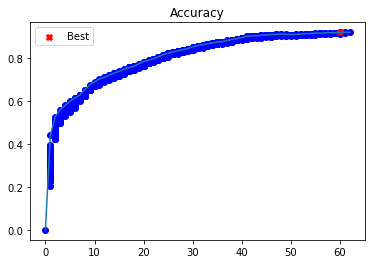

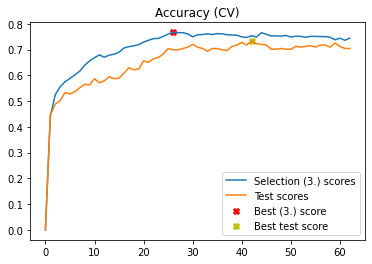

In [45]:
#Percentage of data used for the test
split_test_size = 0.25

#Seed used for the division of all data
seed = 40

#Dividing the dataset in train and test set    
X_train, X_val, y_train, y_val = train_test_split(X_class_small, train_kingdom_enc_small.iloc[:,1],
                                                test_size = split_test_size, 
                                                random_state = seed)

cv = 5
features, score = forward_selection(X_train, y_train, X_val, y_val,'logistic',
                  get_evaluator(make_scorer(accuracy)), np.argmax, # 2.
                  get_cv_evaluator(make_scorer(accuracy), cv), np.argmax, # 3.
                  get_evaluator(make_scorer(accuracy)), np.argmax, # test
                  candidates_scorer_name="Accuracy",
                  subsets_scorer_name="Accuracy (CV)",
                  verbose=True, weight_step3=cv)

Now we can try to see what is the accuracy of the model with less features using all the data avaiable. We can see that is almost identical.

In [46]:
X_forward_sel = X_class[features]

score_feature_sel_Log = cross_val_score(LogisticRegression(solver = "newton-cg", penalty = 'none', multi_class = 'ovr'),
                        X_forward_sel, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'Logistic Regression with feature selection', 'Validation score':np.mean(score_feature_sel_Log)}, ignore_index = True)
print(f'The score of the 5 validation set is: {score_feature_sel_Log}')
print(f'The average score is {np.mean(score_feature_sel_Log)}')

The score of the 5 validation set is: [0.75971223 0.75395683 0.75575816 0.75239923 0.75671785]
The average score is 0.7557088609342852


The second alternative in order to reduce the dimensionality of our dataset are shrinkage methods. Those are both Lasso and Ridge, what they do is basically shrink the coefficient of some variables towards 0, they use a penalty system. To use them we can't use anymore the newton-cg solver but we have to use the saga solver. To test all the values of C, which is a coefficient of the penalty term, and find the best one we will make use of the GridSearchCV function. The basic idea behind this function is do cross validation with every possible combination of the terms that we use.

In [47]:
C_value = np.arange(0.0001, 0.5, 0.05)

from sklearn import preprocessing
X_class_std = preprocessing.scale(X_class_small)   #First we have to scale our parameters

Log_hyparams = GridSearchCV(LogisticRegression(solver = 'saga', multi_class = 'ovr'), {
    'penalty':['l1', 'l2'],
    'C': C_value
}, cv = 5, return_train_score = False)       #Parameters that can vary are C and the type of penalty(Ridge/Lasso)

#Then we train the model 
Log_hyparams.fit(X_class_std, train_kingdom_enc_small.iloc[:,1])
#And we print as a result a dataframe containing all the combination of the parameters with their validation score
pd.DataFrame(Log_hyparams.cv_results_, columns = ['params', 'mean_test_score', 'std_test_score', 'rank_test_score']).sort_values(by="rank_test_score")

#then we select the best parameters and we train a new model with those
best_param = Log_hyparams.best_params_
best_C = best_param['C']
best_penalty = best_param['penalty']

#On the model that we have train now we compute the test score
print(f'The best parameters are: {best_param}')

GridSearchCV(cv=5,
             estimator=LogisticRegression(multi_class='ovr', solver='saga'),
             param_grid={'C': array([1.000e-04, 5.010e-02, 1.001e-01, 1.501e-01, 2.001e-01, 2.501e-01,
       3.001e-01, 3.501e-01, 4.001e-01, 4.501e-01]),
                         'penalty': ['l1', 'l2']})

,params,mean_test_score,std_test_score,rank_test_score
19,"{'C': 0.4501, 'penalty': 'l2'}",0.778000,0.011851,1
16,"{'C': 0.4001, 'penalty': 'l1'}",0.777333,0.013400,2
12,"{'C': 0.30010000000000003, 'penalty': 'l1'}",0.777333,0.018903,2
17,"{'C': 0.4001, 'penalty': 'l2'}",0.776667,0.011926,4
9,"{'C': 0.2001, 'penalty': 'l2'}",0.776667,0.010954,4
18,"{'C': 0.4501, 'penalty': 'l1'}",0.776667,0.012472,6
10,"{'C': 0.2501, 'penalty': 'l1'}",0.776000,0.017436,7
14,"{'C': 0.3501, 'penalty': 'l1'}",0.776000,0.014048,7
11,"{'C': 0.2501, 'penalty': 'l2'}",0.775333,0.012037,9
13,"{'C': 0.30010000000000003, 'penalty': 'l2'}",0.774000,0.011624,10


The best parameters are: {'C': 0.4501, 'penalty': 'l2'}


Now we train the model with the parameters obtained from the GridSearchCV function. The results that we obtain are very similar to the one that we had before in terms of accuracy.

In [48]:
model_l2 = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('classifier',LogisticRegression(solver = 'saga', penalty = best_penalty, C = best_C, max_iter = 4000, multi_class = 'ovr'))])
score_l2 = cross_val_score(model_l2, X_class, train_kingdom_enc.iloc[:,1], cv=5)
results = results.append({'Model':'Logistic regression with l2 penalty', 'Validation score':np.mean(score_l2)}, ignore_index = True)
print("CV accuracy: ",np.mean(score_l2))

CV accuracy:  0.8159654694670367


Finally we can visualize the parameters beta for this model, since we are in a multiclass problem we have 11 models because we use a one vs rest (ovr) scheme. Given that we are training a model with l2 regularization our parameters are not shrinked exactly to 0 but they are only close. This is different from would have happened with an l1 regularization.

Pipeline(steps=[('scaler', StandardScaler()),
                ('classifier',
                 LogisticRegression(C=0.4501, max_iter=4000, multi_class='ovr',
                                    solver='saga'))])

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='0'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='1'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='2'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='3'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='4'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='5'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='6'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='7'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='8'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='9'>

<Figure size 720x720 with 0 Axes>

<AxesSubplot:xlabel='10'>

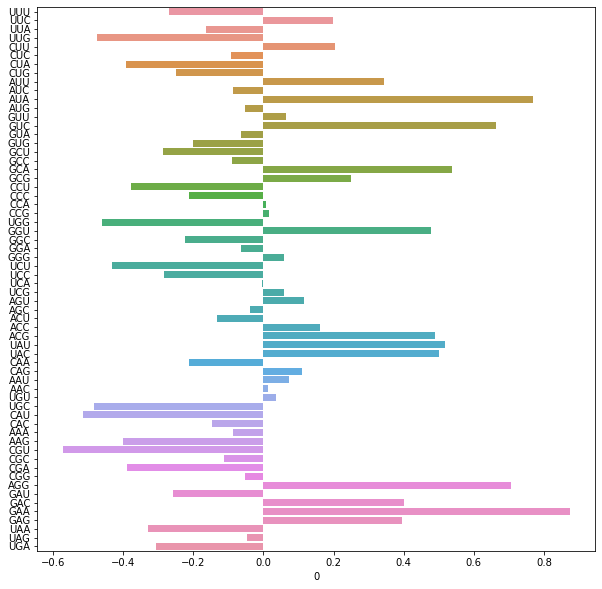

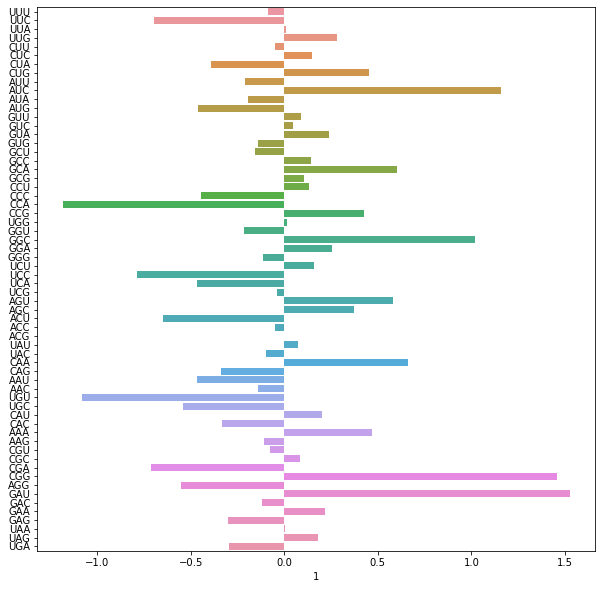

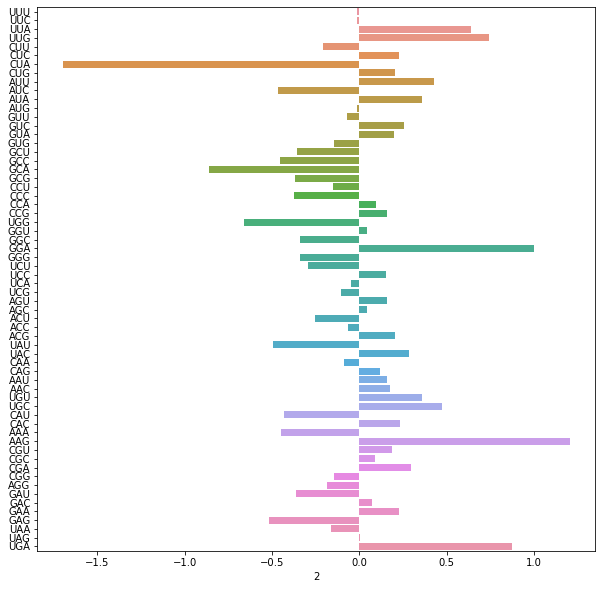

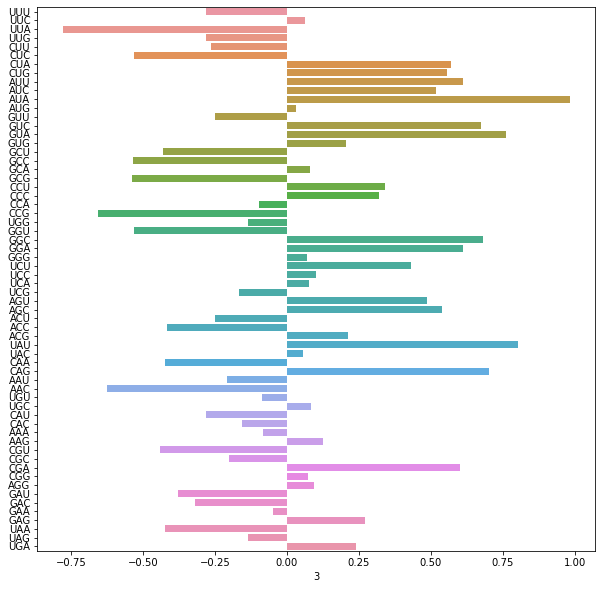

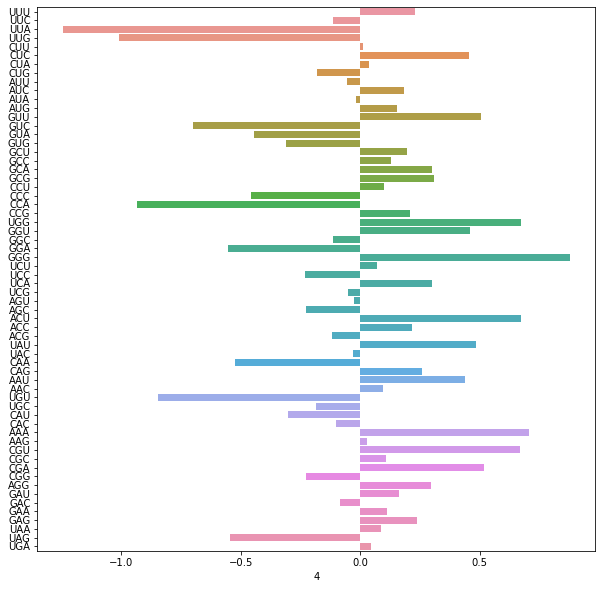

...

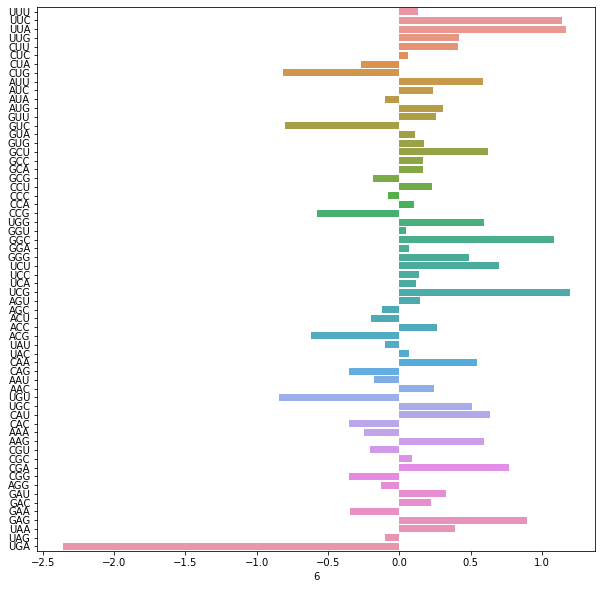

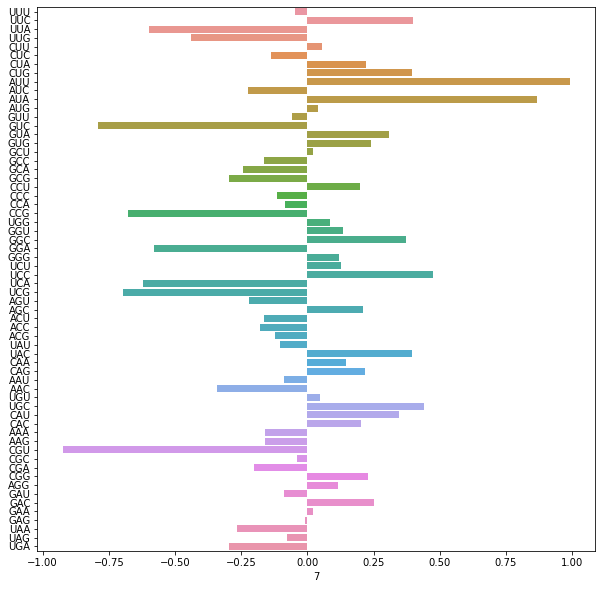

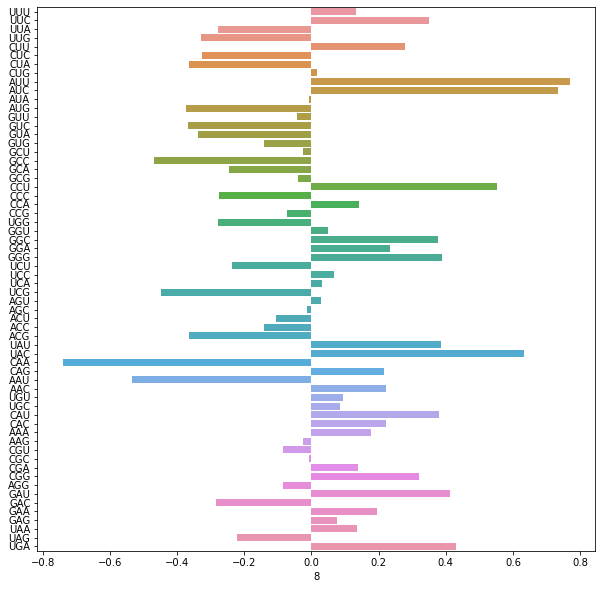

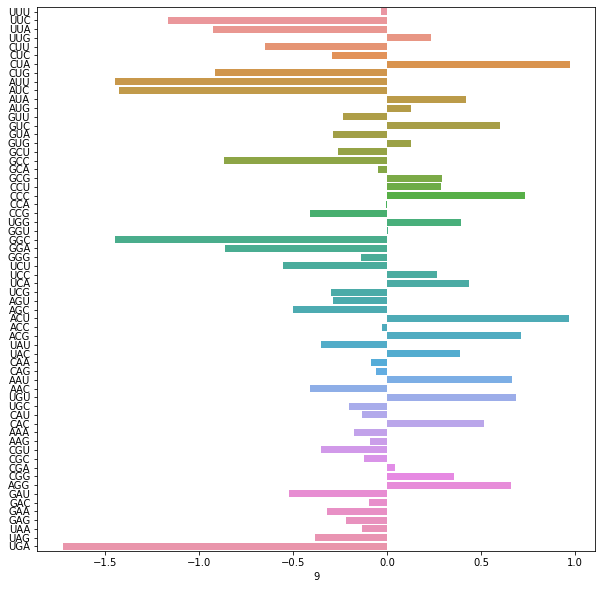

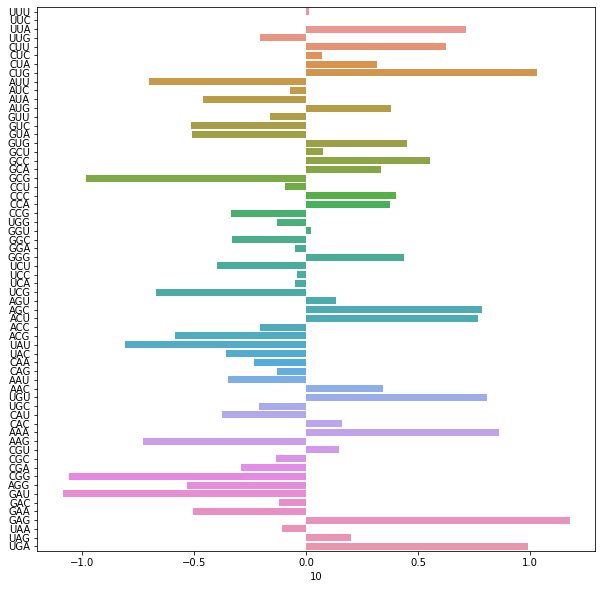

In [49]:
model_l2.fit(X_train, y_train)
betas = pd.DataFrame(model_l2['classifier'].coef_)
betas.columns = X_train.columns

for i in range(len(betas)):
    plt.figure(figsize=(10,10))
    sns.barplot(x= betas.iloc[i,:], y = X_class.columns)

Finally we can observe that acorss those models we have some coefficient that are high in general and others that are closer to 0 which seems to be less important for the classification. 

In [50]:
ab_val = np.abs(betas)                  #Compute the absolute values and then the mean
n = np.mean(ab_val, axis = 0)
print(f'Codon {n.index[np.argmax(n)]} has the highest mean value: {np.max(n)}')
print(f'Codon {n.index[np.argmin(n)]} has the lowest mean value: {np.min(n)}')

Codon UGA has the highest mean value: 0.6898630953659431
Codon CGC has the lowest mean value: 0.09081437047640016


The last method to reduce the dimensionality of the dataset is to use Principal Component Analysis, however I don't think is a good idea in this case. In general we use logistic regression because of its interpretability, if we use PCA we would completely lose the interpretability so we will not use it with this algorithm. 

## Linear Discriminant Analysis

The next classifier that we are going to consider is Linear Discriminant Analysis, this type of classifier is pretty simple and it is very used in a multiclass settings like this one. As we have done for logistic regression the first thing that we do is trying to train the model without feature selection.

In [51]:
LDA_score = cross_val_score(LDA(), X_class, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'LDA', 'Validation score':np.mean(LDA_score)}, ignore_index = True)
print(f'The average score of cross validation is: {np.mean(LDA_score)}')

The average score of cross validation is: 0.79025016455166


Given that LDA is much more faster to train we can do feature selection using all the samples we have.

............
Best model (M1) with 1 features: ['CUA']
M1 subset score (3.): 0.40161225134299733
............
Best model (M2) with 2 features: ['CUA', 'UGU']
M2 subset score (3.): 0.48579760870383365
............
Best model (M3) with 3 features: ['CUA', 'UGU', 'CCC']
M3 subset score (3.): 0.5400460292604066
............
Best model (M4) with 4 features: ['CUA', 'UGU', 'CCC', 'UGA']
M4 subset score (3.): 0.5648664038760793
............
Best model (M5) with 5 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC']
M5 subset score (3.): 0.5916054279510352
............
Best model (M6) with 6 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU']
M6 subset score (3.): 0.6175784158276512
............
Best model (M7) with 7 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU']
M7 subset score (3.): 0.6349783107768685
............
Best model (M8) with 8 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA']
M8 subset score (3.): 0.649308006604127
............
Best model (M9) with 9 feature

............
Best model (M38) with 38 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA', 'GGC', 'UCC', 'AAG', 'CUG', 'GGA', 'GCC', 'UUA', 'UUG', 'CCA', 'UGC', 'CGG', 'AGC', 'GCA', 'UAC', 'AGG', 'GAG', 'AUC', 'GUA', 'CCU', 'CCG', 'AUG', 'CAG', 'AUA', 'UAU', 'CAU', 'UCU', 'UAG', 'AAA', 'GAU', 'ACG']
M38 subset score (3.): 0.7771243739087892
............
Best model (M39) with 39 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA', 'GGC', 'UCC', 'AAG', 'CUG', 'GGA', 'GCC', 'UUA', 'UUG', 'CCA', 'UGC', 'CGG', 'AGC', 'GCA', 'UAC', 'AGG', 'GAG', 'AUC', 'GUA', 'CCU', 'CCG', 'AUG', 'CAG', 'AUA', 'UAU', 'CAU', 'UCU', 'UAG', 'AAA', 'GAU', 'ACG', 'CGU']
M39 subset score (3.): 0.7786603734375331
............
Best model (M40) with 40 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA', 'GGC', 'UCC', 'AAG', 'CUG', 'GGA', 'GCC', 'UUA', 'UUG', 'CCA', 'UGC', 'CGG', 'AGC', 'GCA', 'UAC', 'AGG', 'GAG', 'AUC', 'GUA', 'CCU', 'CCG', 'AUG', 'CAG', 'AUA', 'UAU', 'CAU',

............
Best model (M58) with 58 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA', 'GGC', 'UCC', 'AAG', 'CUG', 'GGA', 'GCC', 'UUA', 'UUG', 'CCA', 'UGC', 'CGG', 'AGC', 'GCA', 'UAC', 'AGG', 'GAG', 'AUC', 'GUA', 'CCU', 'CCG', 'AUG', 'CAG', 'AUA', 'UAU', 'CAU', 'UCU', 'UAG', 'AAA', 'GAU', 'ACG', 'CGU', 'UCG', 'GUC', 'UUU', 'AAC', 'UAA', 'CGC', 'GCU', 'GUU', 'GUG', 'GAC', 'AGU', 'ACU', 'CGA', 'CUC', 'GGU', 'ACC', 'GGG', 'CAA', 'GCG']
M58 subset score (3.): 0.7850573443096673
............
Best model (M59) with 59 features: ['CUA', 'UGU', 'CCC', 'UGA', 'UUC', 'CUU', 'AUU', 'GAA', 'GGC', 'UCC', 'AAG', 'CUG', 'GGA', 'GCC', 'UUA', 'UUG', 'CCA', 'UGC', 'CGG', 'AGC', 'GCA', 'UAC', 'AGG', 'GAG', 'AUC', 'GUA', 'CCU', 'CCG', 'AUG', 'CAG', 'AUA', 'UAU', 'CAU', 'UCU', 'UAG', 'AAA', 'GAU', 'ACG', 'CGU', 'UCG', 'GUC', 'UUU', 'AAC', 'UAA', 'CGC', 'GCU', 'GUU', 'GUG', 'GAC', 'AGU', 'ACU', 'CGA', 'CUC', 'GGU', 'ACC', 'GGG', 'CAA', 'GCG', 'CAC']
M59 subset score (3.): 0.7858250168130341

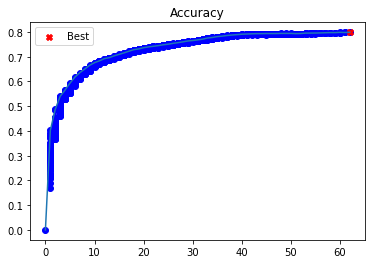

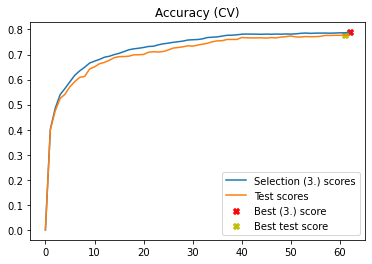

In [52]:
warnings.filterwarnings('ignore')

X_train_full, X_val_full, y_train_full, y_val_full = train_test_split(X_class, train_kingdom_enc.iloc[:,1],
                                                     test_size = split_test_size, 
                                                     random_state = seed)

cv = 5
features, score = forward_selection(X_train_full, y_train_full, X_val_full, y_val_full,'LDA',
                  get_evaluator(make_scorer(accuracy)), np.argmax, # 2.
                  get_cv_evaluator(make_scorer(accuracy), cv), np.argmax, # 3.
                  get_evaluator(make_scorer(accuracy)), np.argmax, # test
                  candidates_scorer_name="Accuracy",
                  subsets_scorer_name="Accuracy (CV)",
                  verbose=True, weight_step3=cv)

It seems to be that the best model is the one which contains all the features avaiable. Since the algorithm is really fast this is not a problem time-wise.

In [53]:
model_LDA = Pipeline([('poly', PolynomialFeatures()),
                  ('lda', LDA(store_covariance=True))])
params = {'poly__degree': range(1, 3)}
cvi = GridSearchCV(model_LDA, params, return_train_score = False, cv = 5)
cvi.fit(X_class, train_kingdom_enc.iloc[:,1])
cvi.best_params_
cvi.best_score_
pd.DataFrame(cvi.cv_results_)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('poly', PolynomialFeatures()),
                                       ('lda',
                                        LinearDiscriminantAnalysis(store_covariance=True))]),
             param_grid={'poly__degree': range(1, 3)})

{'poly__degree': 2}

0.9037616739621738

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_poly__degree,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.105311,0.023154,0.003792,0.000978,1,{'poly__degree': 1},0.793285,0.800000,0.785988,0.770154,0.801823,0.790250,0.011491,2
1,10.776423,0.252305,0.063830,0.008053,2,{'poly__degree': 2},0.909353,0.894005,0.907390,0.899712,0.908349,0.903762,0.005951,1


In [54]:
final_LDA = Pipeline([
    ('poly', PolynomialFeatures(degree = 2)),
    ('lda', LDA(store_covariance=True))])

final_LDA_score = cross_val_score(final_LDA, X_class, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'LDA with polynomial features, 2 degrees', 'Validation score':np.mean(final_LDA_score)}, ignore_index = True)
print(f'The average score of cross validation is: {np.mean(final_LDA_score)}')

The average score of cross validation is: 0.9037616739621738


Using features combined to have an higher degree we are able to improve the performance of our model which seems to be better than the original one.

## Quadratic Discriminant Analysis

Since we have seen Linear Discriminant Analysis and we have obtained pretty good results with it now we take a look to Quadratic Discriminant Analysis. This algorithm is a bit more complex, we will lose interpretability, we will reduce the bias and increase variance. Let's see if this result in a better overall performance or not.

In [55]:
QDA_score = cross_val_score(QDA(), X_class, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'QDA', 'Validation score':np.mean(QDA_score)}, ignore_index = True)
print(f'The average score of cross validation is: {np.mean(QDA_score)}')

The average score of cross validation is: 0.8186517350419088


............
Best model (M1) with 1 features: ['CUA']
M1 subset score (3.): 0.4437066072360681
............
Best model (M2) with 2 features: ['CUA', 'AUU']
M2 subset score (3.): 0.5252054790037521
............
Best model (M3) with 3 features: ['CUA', 'AUU', 'UGU']
M3 subset score (3.): 0.5721607244249616
............
Best model (M4) with 4 features: ['CUA', 'AUU', 'UGU', 'UUC']
M4 subset score (3.): 0.6086236547527297
............
Best model (M5) with 5 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU']
M5 subset score (3.): 0.6357469650632513
............
Best model (M6) with 6 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG']
M6 subset score (3.): 0.6554503684140768
............
Best model (M7) with 7 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA']
M7 subset score (3.): 0.6774571165360077
............
Best model (M8) with 8 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC']
M8 subset score (3.): 0.6934475801503109
............
Best model (M9) with 9 features

............
Best model (M38) with 38 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC', 'GCC', 'AAG', 'CCA', 'GGA', 'CCU', 'GGC', 'GUG', 'ACU', 'GAU', 'GGG', 'GUA', 'GUC', 'CAC', 'UGG', 'UCC', 'UUG', 'AUC', 'GCA', 'CGU', 'AUA', 'GCG', 'UAC', 'AUG', 'ACG', 'AGG', 'CAG', 'UCU', 'UCG', 'UGC', 'CAU']
M38 subset score (3.): 0.8267653685858889
............
Best model (M39) with 39 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC', 'GCC', 'AAG', 'CCA', 'GGA', 'CCU', 'GGC', 'GUG', 'ACU', 'GAU', 'GGG', 'GUA', 'GUC', 'CAC', 'UGG', 'UCC', 'UUG', 'AUC', 'GCA', 'CGU', 'AUA', 'GCG', 'UAC', 'AUG', 'ACG', 'AGG', 'CAG', 'UCU', 'UCG', 'UGC', 'CAU', 'GAG']
M39 subset score (3.): 0.8298359767841041
............
Best model (M40) with 40 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC', 'GCC', 'AAG', 'CCA', 'GGA', 'CCU', 'GGC', 'GUG', 'ACU', 'GAU', 'GGG', 'GUA', 'GUC', 'CAC', 'UGG', 'UCC', 'UUG', 'AUC', 'GCA', 'CGU', 'AUA', 'GCG', 'UAC', 'AUG', 'ACG', 'AGG',

............
Best model (M58) with 58 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC', 'GCC', 'AAG', 'CCA', 'GGA', 'CCU', 'GGC', 'GUG', 'ACU', 'GAU', 'GGG', 'GUA', 'GUC', 'CAC', 'UGG', 'UCC', 'UUG', 'AUC', 'GCA', 'CGU', 'AUA', 'GCG', 'UAC', 'AUG', 'ACG', 'AGG', 'CAG', 'UCU', 'UCG', 'UGC', 'CAU', 'GAG', 'CCG', 'CGG', 'UAU', 'AGC', 'AAU', 'AGU', 'CGA', 'AAA', 'UUU', 'AAC', 'CGC', 'GCU', 'GUU', 'UAA', 'GGU', 'ACC', 'GAC', 'CUC', 'UCA']
M58 subset score (3.): 0.8236950876486787
............
Best model (M59) with 59 features: ['CUA', 'AUU', 'UGU', 'UUC', 'CUU', 'CUG', 'GAA', 'CCC', 'GCC', 'AAG', 'CCA', 'GGA', 'CCU', 'GGC', 'GUG', 'ACU', 'GAU', 'GGG', 'GUA', 'GUC', 'CAC', 'UGG', 'UCC', 'UUG', 'AUC', 'GCA', 'CGU', 'AUA', 'GCG', 'UAC', 'AUG', 'ACG', 'AGG', 'CAG', 'UCU', 'UCG', 'UGC', 'CAU', 'GAG', 'CCG', 'CGG', 'UAU', 'AGC', 'AAU', 'AGU', 'CGA', 'AAA', 'UUU', 'AAC', 'CGC', 'GCU', 'GUU', 'UAA', 'GGU', 'ACC', 'GAC', 'CUC', 'UCA', 'CAA']
M59 subset score (3.): 0.8216479064295334

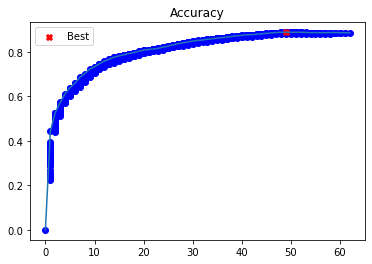

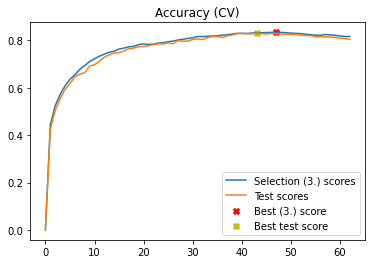

In [56]:
X_train_full, X_val_full, y_train_full, y_val_full = train_test_split(X_class, train_kingdom_enc.iloc[:,1],
                                                     test_size = split_test_size, 
                                                     random_state = seed)

cv = 5
features, score = forward_selection(X_train_full, y_train_full, X_val_full, y_val_full,'QDA',
                  get_evaluator(make_scorer(accuracy)), np.argmax, # 2.
                  get_cv_evaluator(make_scorer(accuracy), cv), np.argmax, # 3.
                  get_evaluator(make_scorer(accuracy)), np.argmax, # test
                  candidates_scorer_name="Accuracy",
                  subsets_scorer_name="Accuracy (CV)",
                  verbose=True, weight_step3=cv)

In [57]:
X_forward_sel = X_class[features]

score_feature_sel_QDA = cross_val_score(QDA(store_covariance = True),
                        X_forward_sel, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'QDA with feature selection', 'Validation score':np.mean(score_feature_sel_QDA)}, ignore_index = True)
print(f'The score of the 5 validation set is: {score_feature_sel_QDA}')
print(f'The average score is {np.mean(score_feature_sel_QDA)}')

The score of the 5 validation set is: [0.8470024  0.8235012  0.83349328 0.8243762  0.83877159]
The average score is 0.8334289343956696


## Support Vector Machine

Support vector machine is the last classifier that we will use. The theory behind this algorithm is more complex with respect to the one of the previous two. With SVM not only we try to find the boundary that separate the classes (if they are separable), but we are searching the boundary that guarantees the maximum distance from the closest point of each of the two classes. Generally this algorithm is applied in the binary case, where we have only 2 classes, but this is not the case since we have 11. However, in sklearn is implemented the one vs rest functionality (default for sklearn) which basically divides the data points in class x and rest.

In this case since with SVM the level of interpretability of the coefficients is low we will also try the thirs methods avaiable for dimensionality reduction which is PCA.

As always, the first thing we do is trying to see the performance of the model using default parameters.

In [58]:
SVM_score = cross_val_score(SVC(decision_function_shape = 'ovr'), X_class, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'Simple SVM', 'Validation score':np.mean(SVM_score)}, ignore_index = True)
print(f'The average score of cross validation is: {np.mean(SVM_score)}')

The average score of cross validation is: 0.8903281367228674


In [59]:
pca = PCA(n_components = 25)         #Specifying that we want 25 components

X_class_PCA = pca.fit_transform(X_class)             #Transform our data in a smaller space and plot the data
pd.DataFrame(X_class_PCA)

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,-0.010931,-0.016793,-0.011822,-0.009518,-0.008227,-0.013058,-0.009917,-0.002621,-0.012181,-0.002727,...,-0.002236,0.007822,0.003738,-0.001372,-0.004517,0.004709,0.003259,0.011070,0.009187,0.006449
1,0.041556,-0.021360,-0.028221,-0.008295,-0.003374,0.003514,-0.007444,-0.007463,0.018780,-0.008596,...,0.010957,0.006998,-0.002019,0.004267,0.017211,0.004766,-0.004496,0.014125,0.005097,-0.004596
2,-0.043538,-0.037133,-0.004721,0.030514,-0.010998,0.008388,-0.021804,0.007190,0.011241,0.005160,...,0.006117,0.000760,0.008978,-0.001458,-0.001803,0.002109,-0.013895,-0.003980,-0.005847,0.003559
3,0.023773,-0.021690,0.009206,0.017443,-0.011201,0.002941,0.008569,0.002285,-0.002816,-0.009201,...,-0.009312,-0.005262,0.001248,0.001159,-0.000260,0.003670,0.010219,-0.002087,-0.002384,0.002269
4,-0.025468,0.066503,-0.000092,-0.005228,-0.022514,0.029082,0.019805,-0.017205,-0.012106,0.026590,...,0.028489,0.004784,0.002757,0.003074,0.013817,0.001697,-0.004375,0.004616,-0.014253,0.003073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,0.022782,-0.015541,-0.009534,-0.015805,-0.000914,-0.015125,0.005584,0.005888,-0.002461,0.012244,...,-0.008118,-0.007734,-0.001001,0.000578,-0.010777,0.003337,0.004086,-0.009465,0.006563,-0.009282
10418,0.016626,-0.010164,-0.011412,-0.001756,0.002691,-0.017208,-0.009710,-0.001590,-0.014727,0.006518,...,0.004291,-0.003296,0.001201,-0.007909,-0.007820,0.002403,0.000285,-0.010532,-0.003200,0.000135
10419,0.073885,-0.001422,0.029996,0.017548,0.002746,0.012684,0.001504,-0.012703,-0.001814,0.004572,...,-0.003573,-0.012075,-0.005362,0.009975,0.005892,-0.006021,0.018630,0.001709,-0.001016,0.006464
10420,-0.063313,-0.028731,0.016944,-0.005017,0.045187,-0.000793,0.017979,0.010365,0.011256,-0.003120,...,-0.033568,0.012605,-0.009138,0.013457,0.001361,0.008467,0.004659,0.000560,0.003971,0.003829


In [60]:
SVM_score_PCA = cross_val_score(SVC(decision_function_shape = 'ovr'), X_class_PCA, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'SVM with PCA, 25 features', 'Validation score':np.mean(SVM_score_PCA)}, ignore_index = True)
print(f'The average score of cross validation with PCA is: {np.mean(SVM_score_PCA)}')

The average score of cross validation with PCA is: 0.8434084057130494


Like with the previous algorithms to reduce dimensionality we can see that the lower the number of features the lower the accuracy, moreover we have not a significant improvent in time to train the model. So even in this case we will use a model with all the 62 features.

Now in order to improve our performances we will try to tune the kernel used. The kernel trick is used to search a linear boundary in our current space, to do that we search a non linear boundary in a higher dimensional space. 

In [61]:
#In SVM the parameter to tune is the kernel we are going to use. 
SVC_hyparams = GridSearchCV(SVC(), {
    'kernel':['linear', 'poly', 'rbf', 'sigmoid']
}, cv = 5, return_train_score = False)

#We train the model
SVC_hyparams.fit(X_class_small, train_kingdom_enc_small.iloc[:,1])
#We compute the validation score for every paramter combination
pd.DataFrame(SVC_hyparams.cv_results_, columns = ['params', 'mean_test_score', 'std_test_score', 'rank_test_score'])

#We select the best paramter according to GridSearchCV
best_param = SVC_hyparams.best_params_
best_kernel = best_param['kernel']

#And finally we compute the test score for the new model
print(f'The best parameters are: {best_param}')

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid']})

,params,mean_test_score,std_test_score,rank_test_score
0,{'kernel': 'linear'},0.436667,0.016465,3
1,{'kernel': 'poly'},0.832000,0.016546,1
2,{'kernel': 'rbf'},0.803333,0.017512,2
3,{'kernel': 'sigmoid'},0.344000,0.026949,4


The best parameters are: {'kernel': 'poly'}


Polynomial kernel seems to be the best so now we take a look at the best degree that we can use.

In [62]:
SVM_score_poly = cross_val_score(SVC(decision_function_shape = 'ovr', kernel = 'poly'), X_class, train_kingdom_enc.iloc[:,1], cv = 5)
results = results.append({'Model':'SVM with polynomial kernel', 'Validation score':np.mean(SVM_score_poly)}, ignore_index = True)
print(f'The average score of cross validation is: {np.mean(SVM_score_poly)}')

The average score of cross validation is: 0.9090381897936544


In [63]:
SVC_hyparams_deg = GridSearchCV(SVC(kernel = 'poly'), {
    'degree': range(1,6)
}, cv = 5, return_train_score = False)

#We train the model
SVC_hyparams_deg.fit(X_class_small, train_kingdom_enc_small.iloc[:,1])
#We compute the validation score for every paramter combination
pd.DataFrame(SVC_hyparams_deg.cv_results_, columns = ['params', 'mean_test_score', 'std_test_score', 'rank_test_score'])

#We select the best paramter according to GridSearchCV
best_param = SVC_hyparams_deg.best_params_
best_degree = best_param['degree']

#And finally we compute the test score for the new model
print(f'The best parameters are: {best_param}')

GridSearchCV(cv=5, estimator=SVC(kernel='poly'),
             param_grid={'degree': range(1, 6)})

,params,mean_test_score,std_test_score,rank_test_score
0,{'degree': 1},0.761333,0.014079,5
1,{'degree': 2},0.812667,0.018667,4
2,{'degree': 3},0.832000,0.016546,1
3,{'degree': 4},0.832000,0.013597,1
4,{'degree': 5},0.826000,0.008273,3


The best parameters are: {'degree': 3}


We can see that degree 3 and 4 have the same score. We already seen degree 3 before because it is the default parameter so now we take a look to degree 4.

In [64]:
SVM_score_poly_4 = cross_val_score(SVC(decision_function_shape = 'ovr', kernel = 'poly', degree = 4), X_class, train_kingdom_enc.iloc[:,1], cv = 5)
print(f'The average score of cross validation is: {np.mean(SVM_score_poly_4)}')

The average score of cross validation is: 0.908270619588782


They have pretty much the same accuracy.

## Final results 

Now that we have take a look to all the models trained on the training set we will choose the best one and use all the training set to estimate the performances on the test set. Since we have two models with a similar score we will take in consideration both of them.

,Model,Validation score
0,Simple Logistic Regression,0.819324
1,Logistic Regression with feature selection,0.755709
2,Logistic regression with l2 penalty,0.815965
3,LDA,0.790250
4,"LDA with polynomial features, 2 degrees",0.903762
5,QDA,0.818652
6,QDA with feature selection,0.833429
7,Simple SVM,0.890328
8,"SVM with PCA, 25 features",0.843408
9,SVM with polynomial kernel,0.909038


<Figure size 1080x1080 with 0 Axes>

<AxesSubplot:xlabel='Validation score', ylabel='Model'>

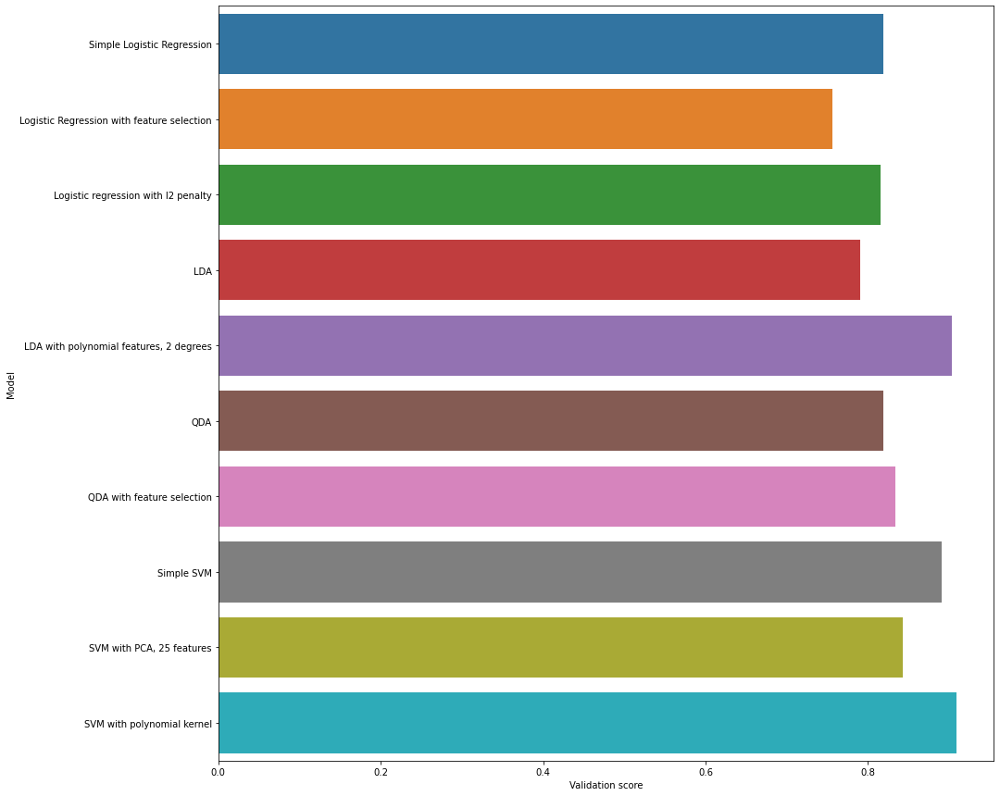

In [65]:
results
plt.figure(figsize = (15,15))
sns.barplot(x = results.iloc[:,1], y = results.iloc[:,0])
X_test = test_data.iloc[:,6::]

The first good model that we have find is LDA with polynomial features. If we train the model on the whole train dataset than we get more than 91% accuracy on the test set, which is the best result we get until now.

In [66]:
LDA_poly_model = Pipeline([
    ('poly', PolynomialFeatures(degree = 2)),
    ('lda', LDA(store_covariance=True))])

LDA_poly_model.fit(X_class, train_kingdom_enc.iloc[:,1])
y_predict_LDA = LDA_poly_model.predict(X_test)

print("Test accuracy:", accuracy(test_kingdom_enc.iloc[:,1], y_predict_LDA))

Pipeline(steps=[('poly', PolynomialFeatures()),
                ('lda', LinearDiscriminantAnalysis(store_covariance=True))])

Test accuracy: 0.9121258633921719


We can see the results of our model in a more specific way using a confusion matrix. The majority of the errors regards class 6, we can see that sometimes it is confused with classes 1,2 and 9 which have the highest number of errors. Class number 6 is plants which are missclassified with virus, bacteria and invertebrates. We knew that this could have happen because when we have plotted the samples in 2D using PCA those kingdoms were really close between each other.

In [67]:
king_dict

,0
0.0,arc
1.0,bct
2.0,inv
3.0,mam
4.0,phg
5.0,plm
6.0,pln
7.0,pri
8.0,rod
9.0,vrl


<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted')

Text(114.0, 0.5, 'Truth')

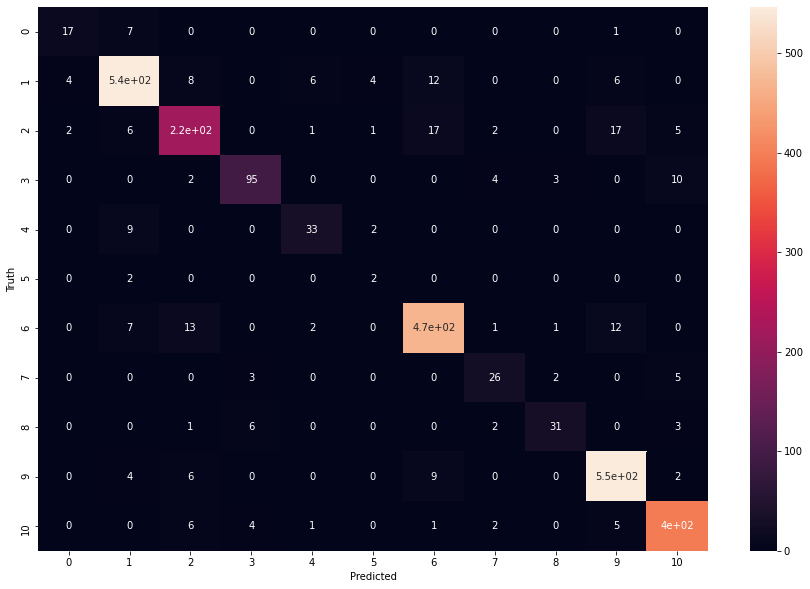

In [68]:
cm = confusion_matrix(test_kingdom_enc.iloc[:,1], y_predict_LDA)
plt.figure(figsize = (15,10))
sns.heatmap(cm, annot = True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

The second model that we test is SVM with a polynomial kernel, with degree 3. The results are not better than the previous with an accuracy of 91%. Looking at the confusion matrix we can see that the distribution ef the errors is pretty much the same as before.

In [69]:
SVM_model = SVC(decision_function_shape = 'ovr', kernel = 'poly', degree = 3)

SVM_model.fit(X_class, train_kingdom_enc.iloc[:,1])
y_predict_SVM = SVM_model.predict(X_test)

print("Test accuracy:", accuracy(test_kingdom_enc.iloc[:,1], y_predict_SVM))

SVC(kernel='poly')

Test accuracy: 0.9109746738296239


<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted')

Text(114.0, 0.5, 'Truth')

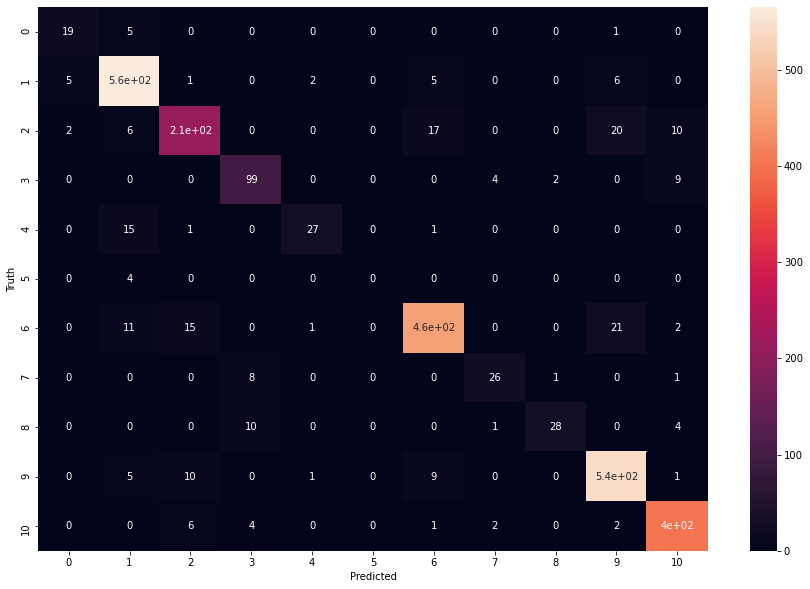

In [70]:
cm_SVM = confusion_matrix(test_kingdom_enc.iloc[:,1], y_predict_SVM)
plt.figure(figsize = (15,10))
sns.heatmap(cm_SVM, annot = True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

In order to have a better understanding of the errors we plot them. As before to plot all the errors we use PCA so that we can visualize them in 2 dimensions. As predictable, the majority of the errors is find in the high density zone which contains bacteria, viruses and plants.

In [71]:
mask = y_predict_LDA == test_kingdom_enc.iloc[:,1]
errors = np.where(mask == False)
errors

(array([   9,   13,   16,   69,   72,   74,  103,  117,  132,  135,  138,
         139,  154,  159,  180,  184,  192,  205,  209,  215,  216,  231,
         246,  248,  256,  257,  268,  278,  289,  292,  307,  309,  320,
         328,  331,  332,  337,  340,  343,  391,  401,  444,  454,  456,
         465,  517,  535,  572,  592,  597,  601,  605,  613,  620,  621,
         627,  628,  663,  665,  677,  711,  717,  733,  737,  739,  761,
         764,  774,  775,  812,  823,  854,  855,  876,  926,  932,  951,
         954,  955,  958,  964,  965,  973,  989, 1003, 1005, 1009, 1026,
        1033, 1045, 1049, 1066, 1068, 1069, 1074, 1095, 1098, 1111, 1144,
        1193, 1194, 1199, 1210, 1213, 1246, 1258, 1260, 1269, 1272, 1289,
        1297, 1305, 1306, 1310, 1319, 1322, 1330, 1331, 1343, 1367, 1371,
        1386, 1392, 1393, 1404, 1407, 1457, 1460, 1461, 1468, 1472, 1489,
        1518, 1538, 1577, 1581, 1585, 1597, 1600, 1606, 1609, 1622, 1632,
        1646, 1647, 1662, 1663, 1681, 

<Figure size 1440x1440 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:>

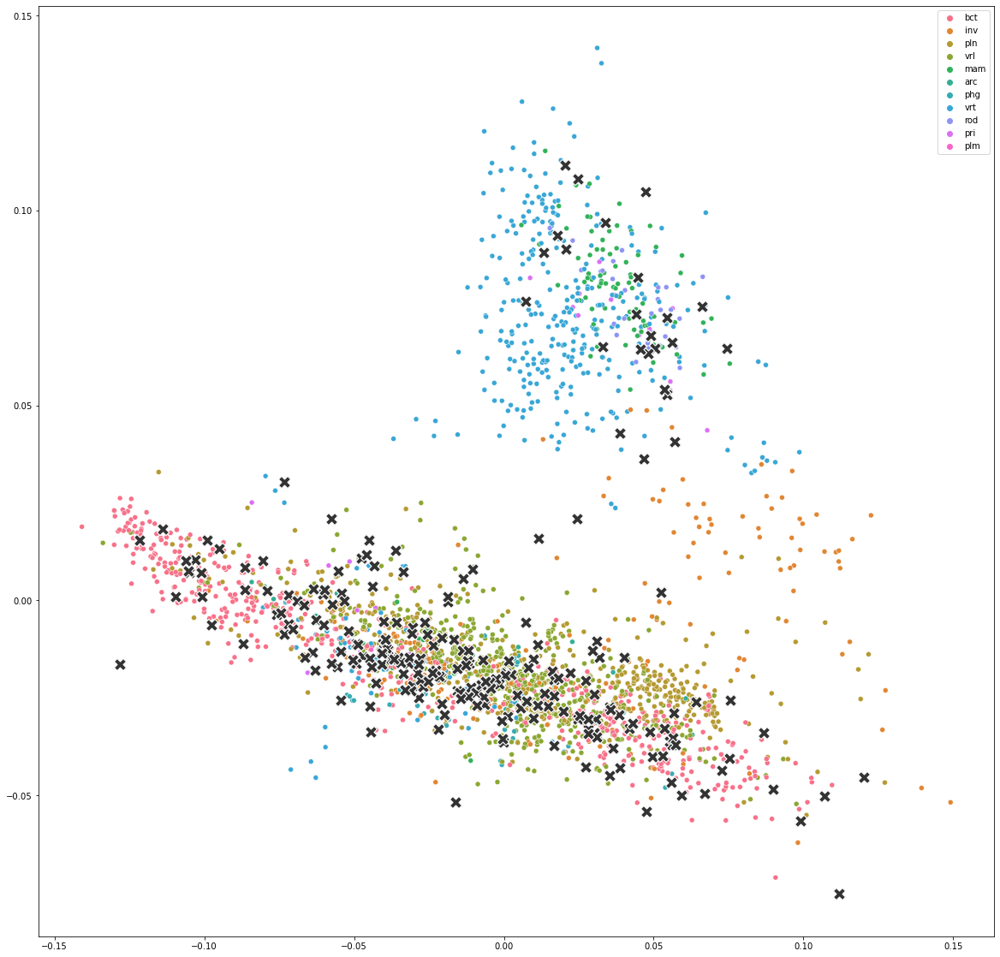

In [72]:
pca = PCA(n_components=2)         #Specifying that we want only 2 components

X_test_PCA = pca.fit_transform(X_test)             #Transform our data in a smaller space and plot the data
X_test_PCA = np.c_[ X_test_PCA, test_kingdom]
plt.figure(figsize = (20,20))
sns.scatterplot(x = X_test_PCA[:,0], y = X_test_PCA[:,1], hue = X_test_PCA[:,2],  data = X_test_PCA)

test_errors = X_test_PCA[errors]

sns.scatterplot(x = test_errors[:,0], y = test_errors[:,1],  data = test_errors, marker = 'X', s = 200, color = '.2')

# Regression

In this section we want to recover the AGA and ACA frequency on the test set, to do that we will train a regressor which is able to predict those frequencies based on the other 62 features. Since we do not have those value on the test set we will only use the train set that we will divide further divide.

In [73]:
X_regr = train_data.iloc[:,6::]                 #Selection of the data
y_regr = X_regr[['AGA', 'ACA']]                 #AGA and ACA will be our y
X_regr = X_regr.drop(['AGA', 'ACA'], axis = 1)
X_regr
y_regr

,UUU,UUC,UUA,UUG,CUU,CUC,CUA,CUG,AUU,AUC,...,CGA,CGG,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA
0,0.01541,0.00927,0.01720,0.01825,0.01436,0.02303,0.01555,0.02094,0.01885,0.01226,...,0.00853,0.00643,0.01182,0.02812,0.00838,0.03365,0.01974,0.01511,0.00030,0.00030
1,0.01213,0.02515,0.00268,0.01352,0.01372,0.01143,0.00775,0.02992,0.01352,0.03370,...,0.00378,0.00268,0.01412,0.03280,0.02555,0.03708,0.05398,0.03330,0.00030,0.00050
2,0.02580,0.01618,0.03606,0.01354,0.00848,0.02067,0.01041,0.00278,0.03250,0.01768,...,0.00570,0.00114,0.00499,0.03756,0.02523,0.05388,0.01946,0.02245,0.00121,0.00086
3,0.00128,0.02141,0.01225,0.01649,0.01330,0.01308,0.00399,0.02834,0.02508,0.02611,...,0.00359,0.01177,0.00422,0.03316,0.02229,0.03444,0.02370,0.00831,0.00028,0.00063
4,0.03169,0.01780,0.03893,0.00000,0.06240,0.01056,0.05262,0.01408,0.03873,0.03873,...,0.01056,0.00000,0.00000,0.00020,0.01389,0.02465,0.00352,0.00352,0.00000,0.02465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,0.02289,0.02959,0.00614,0.02680,0.01452,0.02178,0.00558,0.01228,0.02401,0.01954,...,0.00279,0.00558,0.01173,0.03071,0.01954,0.01787,0.02848,0.03127,0.00112,0.00000
10418,0.02532,0.01557,0.00878,0.01185,0.01160,0.02654,0.00979,0.02313,0.01773,0.01977,...,0.00791,0.00477,0.01008,0.02070,0.00726,0.02388,0.02233,0.01814,0.00025,0.00038
10419,0.01614,0.02618,0.00131,0.01003,0.02661,0.01658,0.00218,0.04712,0.01920,0.03054,...,0.00262,0.01702,0.00567,0.02487,0.00000,0.02661,0.02618,0.01353,0.00000,0.00349
10420,0.00196,0.01761,0.04501,0.03131,0.02544,0.00978,0.01761,0.00783,0.04305,0.00587,...,0.01761,0.00391,0.00391,0.02348,0.01957,0.03523,0.00978,0.00196,0.00000,0.00196


,AGA,ACA
0,0.02064,0.01720
1,0.00915,0.01441
2,0.01775,0.02858
3,0.00705,0.01330
4,0.00000,0.03502
...,...,...
10417,0.00893,0.01675
10418,0.01274,0.02032
10419,0.00175,0.00393
10420,0.01566,0.00391


In [74]:
#Splitting data in train and test set
X_train_regr, X_test_regr, y_train_regr, y_test_regr = train_test_split(X_regr, y_regr,
                                                test_size = split_test_size, 
                                                random_state = seed)

## K Neighbors Regressor

This is a very simple regressor which takes in consideration the n neighbors closer to our test points in order to decide for it's value. We will first try to take a look at the algorithm with standard parameters and then we will try to tune the number of neighbors in order to get a better result. To select the best algorithm we will use the R^2 value wich give us an indication on the goodness of the model.

In [75]:
model = KNeighborsRegressor(n_neighbors = 5)
model.fit(X_train_regr, y_train_regr)
y_train_predict = model.predict(X_train_regr)
y_test_predict = model.predict(X_test_regr)
y_train_predict = pd.DataFrame(y_train_predict)
y_test_predict = pd.DataFrame(y_test_predict)
print('Train R2 score for AGA codon', r2_score(y_train_predict.iloc[:,0], y_train_regr.iloc[:,0]))
print('Test R2 score for AGA codon', r2_score(y_test_predict.iloc[:,0], y_test_regr.iloc[:,0]))
print('Train R2 score for ACA codon', r2_score(y_train_predict.iloc[:,1], y_train_regr.iloc[:,1]))
print('Test R2 score for ACA codon', r2_score(y_test_predict.iloc[:,1], y_test_regr.iloc[:,1]))

KNeighborsRegressor()

Train R2 score for AGA codon 0.8017484465300397
Test R2 score for AGA codon 0.6949743560772932
Train R2 score for ACA codon 0.8185160351362832
Test R2 score for ACA codon 0.7152378826151995


Now we try to see the results using the same model but with a different number of neighbors. A lower number of neighbors could result in overfitting since in the case of n = 1 our model will learn the train set giving bad performances on the test. On the other side a high number of neighbors would result in a too general model with high bias.

In [76]:
KNN_hyparams = GridSearchCV(KNeighborsRegressor(), {
    'n_neighbors':[3,5,7,10,12,15,20,25,30,50]
}, cv = 5, return_train_score = False, refit = "MSE", scoring = {"R^2": make_scorer(r2_score, greater_is_better = True),
                          "MSE": make_scorer(mean_squared_error, greater_is_better = False)})

#We divide our y in aga and aca so that we can fit the model with both data and obtain the results for both of them
y_train_regr_aga = y_train_regr.iloc[:,0]
y_test_regr_aga = y_test_regr.iloc[:,0]
y_train_regr_aca = y_train_regr.iloc[:,1]
y_test_regr_aca = y_train_regr.iloc[:,1]


#We train the model
KNN_hyparams.fit(X_train_regr, y_train_regr_aga)     #Fit the model on the AGA data
#We compute the validation score for every paramter combination
resKNN = pd.DataFrame(KNN_hyparams.cv_results_)
#Sort and print the results
resKNN.sort_values(by="rank_test_R^2")[["param_n_neighbors", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]


KNN_hyparams.fit(X_train_regr, y_train_regr_aca)     #Fit the model on the ACA data

resKNN = pd.DataFrame(KNN_hyparams.cv_results_)
resKNN.sort_values(by="rank_test_R^2")[["param_n_neighbors", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]

GridSearchCV(cv=5, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': [3, 5, 7, 10, 12, 15, 20, 25, 30, 50]},
             refit='MSE',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_n_neighbors,mean_test_R^2,std_test_R^2,rank_test_R^2
1,5,0.745503,0.013552,1
2,7,0.744089,0.011604,2
0,3,0.742030,0.017456,3
3,10,0.737162,0.011626,4
4,12,0.733978,0.010816,5
5,15,0.729341,0.008403,6
6,20,0.722431,0.009202,7
7,25,0.716395,0.009384,8
8,30,0.711860,0.009726,9
9,50,0.696553,0.011060,10


GridSearchCV(cv=5, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': [3, 5, 7, 10, 12, 15, 20, 25, 30, 50]},
             refit='MSE',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_n_neighbors,mean_test_R^2,std_test_R^2,rank_test_R^2
1,5,0.779293,0.013016,1
2,7,0.776673,0.010834,2
0,3,0.776508,0.018471,3
3,10,0.769615,0.009963,4
4,12,0.765284,0.011222,5
5,15,0.760686,0.011561,6
6,20,0.752395,0.010334,7
7,25,0.745504,0.010047,8
8,30,0.738186,0.010216,9
9,50,0.720037,0.010395,10


In this case we see that the ideal number of neighbors in both cases is still 5 which is the number used before. 

## Linear Regression

The next model that we try is a simple linear regression, with this model our output will be a linear combination of the other 62 features. Even in this case we have two different prediction resulting from AGA and ACA.

In [77]:
model_lin_reg = LinearRegression(fit_intercept = True)       #Linear regression using the intercept
model_lin_reg.fit(X_train_regr, y_train_regr)
y_train_predict_lin_reg = model_lin_reg.predict(X_train_regr)
y_test_predict_lin_reg = model_lin_reg.predict(X_test_regr)
y_train_predict_lin_reg = pd.DataFrame(y_train_predict_lin_reg)
y_test_predict_lin_reg = pd.DataFrame(y_test_predict_lin_reg)
print('Train R2 score for AGA codon', r2_score(y_train_predict_lin_reg.iloc[:,0], y_train_regr.iloc[:,0]))
print('Test R2 score for AGA codon', r2_score(y_test_predict_lin_reg.iloc[:,0], y_test_regr.iloc[:,0]))
print('Train R2 score for ACA codon', r2_score(y_train_predict_lin_reg.iloc[:,1], y_train_regr.iloc[:,1]))
print('Test R2 score for ACA codon', r2_score(y_test_predict_lin_reg.iloc[:,1], y_test_regr.iloc[:,1]))

LinearRegression()

Train R2 score for AGA codon 0.7561366717265864
Test R2 score for AGA codon 0.7543695757883608
Train R2 score for ACA codon 0.9066391547940815
Test R2 score for ACA codon 0.9041519838642532


We can see that the results that we obtain are slightly better than the previous one, in particular we have a good R^2 for what is regarding the ACA codon. The next step is trying to improve the results using Ridge and Lasso regression. Those should shrink the parameters beta towards 0 reducing the variability in our model, hence increasing the performance, and improving the interpretability.

## Lasso Regression

The first technique is Lasso regression, it is basically similar to the one that we have seen in the classification setting. Lasso use an l1 penalization term that result in the shrinkage of different parameters exactly to 0, differently from Ridge.

In [78]:
model_lasso = Pipeline([('scaler',preprocessing.StandardScaler()), 
               ('regressor',Lasso())])

C_param = np.linspace(5e-5 ,0.01, 10)    #Penalty terms
params = {'regressor__alpha': C_param}
cv = GridSearchCV(model_lasso, params, refit = "R^2", cv = 5, 
                  scoring = {"R^2": make_scorer(r2_score, greater_is_better = True),
                          "MSE": make_scorer(mean_squared_error, greater_is_better = False)})
cv.fit(X_train_regr, y_train_regr_aga)
resLasso = pd.DataFrame(cv.cv_results_)
resLasso.sort_values(by="rank_test_R^2")[["param_regressor__alpha", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]

cv.fit(X_train_regr, y_train_regr_aca)
resLasso = pd.DataFrame(cv.cv_results_)
resLasso.sort_values(by="rank_test_R^2")[["param_regressor__alpha", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('regressor', Lasso())]),
             param_grid={'regressor__alpha': array([5.00000000e-05, 1.15555556e-03, 2.26111111e-03, 3.36666667e-03,
       4.47222222e-03, 5.57777778e-03, 6.68333333e-03, 7.78888889e-03,
       8.89444444e-03, 1.00000000e-02])},
             refit='R^2',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_regressor__alpha,mean_test_R^2,std_test_R^2,rank_test_R^2
0,5e-05,0.719628,0.007749,1
1,0.00115556,0.594666,0.015016,2
2,0.00226111,0.478830,0.012926,3
3,0.00336667,0.318959,0.013335,4
4,0.00447222,0.142663,0.007607,5
5,0.00557778,-0.001932,0.002204,6
6,0.00668333,-0.001932,0.002204,6
7,0.00778889,-0.001932,0.002204,6
8,0.00889444,-0.001932,0.002204,6
9,0.01,-0.001932,0.002204,6


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('regressor', Lasso())]),
             param_grid={'regressor__alpha': array([5.00000000e-05, 1.15555556e-03, 2.26111111e-03, 3.36666667e-03,
       4.47222222e-03, 5.57777778e-03, 6.68333333e-03, 7.78888889e-03,
       8.89444444e-03, 1.00000000e-02])},
             refit='R^2',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_regressor__alpha,mean_test_R^2,std_test_R^2,rank_test_R^2
0,5e-05,0.812485,0.010512,1
1,0.00115556,0.666858,0.010623,2
2,0.00226111,0.614849,0.009434,3
3,0.00336667,0.546632,0.009450,4
4,0.00447222,0.451826,0.009696,5
5,0.00557778,0.334109,0.009312,6
6,0.00668333,0.204148,0.007880,7
7,0.00778889,0.080108,0.010156,8
8,0.00889444,-0.000255,0.000296,9
9,0.01,-0.000255,0.000296,9


The results that we get are not better than the ones that we have obtained with a simple Linear Regression.

## Ridge Regression

As mentioned before this is a method for shrinking parameters towards 0, however this method use an l2 penalization term making difficult to have parameters that are exactly 0. Many of them however are close to 0.

In [79]:
model_ridge = Pipeline([('scaler', preprocessing.StandardScaler()), 
               ('regressor', Ridge())])

C_param = np.linspace(5e-5 ,0.5, 10)
params = {'regressor__alpha': C_param}
cv = GridSearchCV(model_ridge, params, refit = "MSE", cv = 5, 
                  scoring = {"R^2": make_scorer(r2_score, greater_is_better = True),
                          "MSE": make_scorer(mean_squared_error, greater_is_better = False)})
cv.fit(X_train_regr, y_train_regr_aga)
resRidge = pd.DataFrame(cv.cv_results_)
resRidge.sort_values(by="rank_test_R^2")[["param_regressor__alpha", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]

cv.fit(X_train_regr, y_train_regr_aca)
resRidge = pd.DataFrame(cv.cv_results_)
resRidge.sort_values(by="rank_test_R^2")[["param_regressor__alpha", "mean_test_R^2", "std_test_R^2", "rank_test_R^2"]]

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('regressor', Ridge())]),
             param_grid={'regressor__alpha': array([5.0000e-05, 5.5600e-02, 1.1115e-01, 1.6670e-01, 2.2225e-01,
       2.7780e-01, 3.3335e-01, 3.8890e-01, 4.4445e-01, 5.0000e-01])},
             refit='MSE',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_regressor__alpha,mean_test_R^2,std_test_R^2,rank_test_R^2
0,5e-05,0.794810,0.004054,1
1,0.0556,0.794809,0.004066,2
2,0.11115,0.794808,0.004078,3
3,0.1667,0.794807,0.004090,4
4,0.22225,0.794806,0.004101,5
5,0.2778,0.794804,0.004113,6
6,0.33335,0.794802,0.004125,7
7,0.3889,0.794799,0.004137,8
8,0.44445,0.794797,0.004149,9
9,0.5,0.794794,0.004160,10


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('regressor', Ridge())]),
             param_grid={'regressor__alpha': array([5.0000e-05, 5.5600e-02, 1.1115e-01, 1.6670e-01, 2.2225e-01,
       2.7780e-01, 3.3335e-01, 3.8890e-01, 4.4445e-01, 5.0000e-01])},
             refit='MSE',
             scoring={'MSE': make_scorer(mean_squared_error, greater_is_better=False),
                      'R^2': make_scorer(r2_score)})

,param_regressor__alpha,mean_test_R^2,std_test_R^2,rank_test_R^2
4,0.22225,0.910361,0.007963,1
3,0.1667,0.910361,0.007976,2
5,0.2778,0.910360,0.007950,3
2,0.11115,0.910360,0.007989,4
6,0.33335,0.910359,0.007937,5
1,0.0556,0.910359,0.008002,6
7,0.3889,0.910358,0.007924,7
0,5e-05,0.910357,0.008015,8
8,0.44445,0.910356,0.007911,9
9,0.5,0.910353,0.007899,10


The results with this model seems to be slightly better than the others, however the R^2 that we obtain on the AGA codon is stil too low if we want tom improve our results on the classification problem.

## Final results

Among the different regeressor tested Ridge regression seems to be the best so we will try to see how it performs on the test set. We do not have a direct way to see if the results are good but we will see if they improve our classification performances.

In [80]:
model_ridge = Pipeline([('scaler', preprocessing.StandardScaler()), 
               ('regressor', Ridge(alpha = 0.22225))])
model_ridge.fit(X_regr, y_regr)
y_ridge = model_ridge.predict(X_test)
y_ridge = pd.DataFrame(y_ridge)
y_ridge

Pipeline(steps=[('scaler', StandardScaler()),
                ('regressor', Ridge(alpha=0.22225))])

,0,1
0,0.002306,0.014842
1,0.009763,0.009403
2,0.006513,0.009119
3,0.004782,0.006772
4,0.016558,0.008007
...,...,...
2601,0.013714,0.013751
2602,0.010672,0.010690
2603,-0.004373,0.022822
2604,0.026678,0.027746


Since we aredealing with codon frequency it doesn't make any sense to consider negative values, so every value below 0 is set to 0.

In [81]:
y_ridge = np.where(y_ridge < 0, 0, y_ridge)
y_ridge = pd.DataFrame(y_ridge)

In [82]:
y_ridge = y_ridge.rename(columns = {0: 'AGA', 1: 'ACA'})
X_ridge = pd.concat([X_test, y_ridge], axis = 1)
X_ridge

,UUU,UUC,UUA,UUG,CUU,CUC,CUA,CUG,AUU,AUC,...,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA,AGA,ACA
0,0.00959,0.01359,0.01584,0.01312,0.02491,0.02457,0.01885,0.01269,0.01319,0.03672,...,0.00709,0.02980,0.04135,0.02608,0.03877,0.01183,0.00061,0.00117,0.002306,0.014842
1,0.01223,0.03447,0.00508,0.01811,0.01176,0.02335,0.00413,0.02017,0.01334,0.03161,...,0.01001,0.02621,0.03368,0.02303,0.03066,0.03479,0.00064,0.00064,0.009763,0.009403
2,0.01014,0.03014,0.00145,0.01275,0.01420,0.02521,0.00261,0.01101,0.02492,0.03796,...,0.00174,0.02753,0.02695,0.00637,0.01826,0.03216,0.00116,0.00029,0.006513,0.009119
3,0.03551,0.02892,0.00155,0.01117,0.01224,0.02475,0.00511,0.02233,0.01392,0.03101,...,0.00356,0.02865,0.02401,0.01594,0.03390,0.01628,0.00108,0.00047,0.004782,0.006772
4,0.01662,0.01400,0.02800,0.03412,0.01312,0.02625,0.02100,0.01137,0.03412,0.01750,...,0.01837,0.03062,0.02362,0.03150,0.01575,0.02625,0.00087,0.00525,0.016558,0.008007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2601,0.00694,0.02021,0.00993,0.01316,0.01435,0.01973,0.00921,0.03720,0.01794,0.02607,...,0.01100,0.02213,0.02249,0.03744,0.03373,0.01411,0.00060,0.00167,0.013714,0.013751
2602,0.01400,0.02160,0.01327,0.02326,0.01459,0.00924,0.00480,0.02757,0.02659,0.02615,...,0.00333,0.03314,0.02080,0.04392,0.02105,0.02458,0.00040,0.00065,0.010672,0.010690
2603,0.00264,0.05079,0.02243,0.00132,0.03034,0.07190,0.04156,0.00264,0.03958,0.05079,...,0.00000,0.00660,0.02243,0.01121,0.00264,0.01451,0.00000,0.02375,0.000000,0.022822
2604,0.00000,0.00502,0.05021,0.00837,0.01841,0.01757,0.00586,0.00167,0.03849,0.00586,...,0.00167,0.04770,0.05523,0.08703,0.00418,0.00000,0.00084,0.00000,0.026678,0.027746


In [83]:
X_final = train_data.iloc[:,6::]
X_final

,UUU,UUC,UUA,UUG,CUU,CUC,CUA,CUG,AUU,AUC,...,CGG,AGA,AGG,GAU,GAC,GAA,GAG,UAA,UAG,UGA
0,0.01541,0.00927,0.01720,0.01825,0.01436,0.02303,0.01555,0.02094,0.01885,0.01226,...,0.00643,0.02064,0.01182,0.02812,0.00838,0.03365,0.01974,0.01511,0.00030,0.00030
1,0.01213,0.02515,0.00268,0.01352,0.01372,0.01143,0.00775,0.02992,0.01352,0.03370,...,0.00268,0.00915,0.01412,0.03280,0.02555,0.03708,0.05398,0.03330,0.00030,0.00050
2,0.02580,0.01618,0.03606,0.01354,0.00848,0.02067,0.01041,0.00278,0.03250,0.01768,...,0.00114,0.01775,0.00499,0.03756,0.02523,0.05388,0.01946,0.02245,0.00121,0.00086
3,0.00128,0.02141,0.01225,0.01649,0.01330,0.01308,0.00399,0.02834,0.02508,0.02611,...,0.01177,0.00705,0.00422,0.03316,0.02229,0.03444,0.02370,0.00831,0.00028,0.00063
4,0.03169,0.01780,0.03893,0.00000,0.06240,0.01056,0.05262,0.01408,0.03873,0.03873,...,0.00000,0.00000,0.00000,0.00020,0.01389,0.02465,0.00352,0.00352,0.00000,0.02465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10417,0.02289,0.02959,0.00614,0.02680,0.01452,0.02178,0.00558,0.01228,0.02401,0.01954,...,0.00558,0.00893,0.01173,0.03071,0.01954,0.01787,0.02848,0.03127,0.00112,0.00000
10418,0.02532,0.01557,0.00878,0.01185,0.01160,0.02654,0.00979,0.02313,0.01773,0.01977,...,0.00477,0.01274,0.01008,0.02070,0.00726,0.02388,0.02233,0.01814,0.00025,0.00038
10419,0.01614,0.02618,0.00131,0.01003,0.02661,0.01658,0.00218,0.04712,0.01920,0.03054,...,0.01702,0.00175,0.00567,0.02487,0.00000,0.02661,0.02618,0.01353,0.00000,0.00349
10420,0.00196,0.01761,0.04501,0.03131,0.02544,0.00978,0.01761,0.00783,0.04305,0.00587,...,0.00391,0.01566,0.00391,0.02348,0.01957,0.03523,0.00978,0.00196,0.00000,0.00196


If we take a look at the distribution that we get from the regression we can see that they are pretty different between train and test set, especially for what is regarding AGA codon. This may be due to chance or it may be that the regressor is not good enough. Due to this we expect that the performance of the classifier using those variables won't be better than the previous.

<Figure size 360x360 with 0 Axes>

<AxesSubplot:xlabel='AGA'>

<Figure size 360x360 with 0 Axes>

<AxesSubplot:xlabel='AGA'>

<Figure size 360x360 with 0 Axes>

<AxesSubplot:xlabel='ACA'>

<Figure size 360x360 with 0 Axes>

<AxesSubplot:xlabel='ACA'>

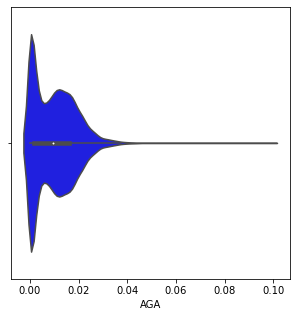

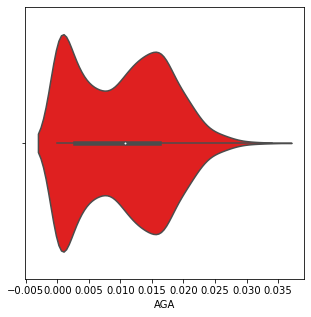

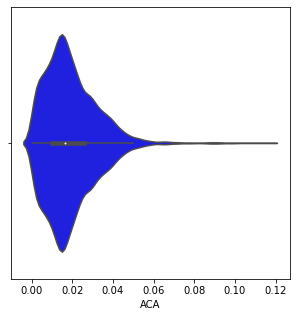

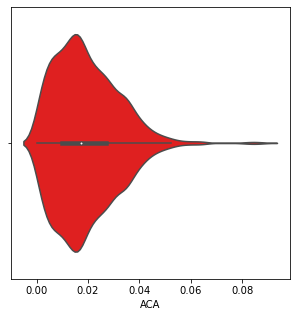

In [84]:
plt.figure(figsize = (5,5))
sns.violinplot(x = X_final["AGA"],color = "blue")
plt.figure(figsize = (5,5))
sns.violinplot(x = X_ridge["AGA"], color = "red")
plt.figure(figsize = (5,5))
sns.violinplot(x = X_final["ACA"],color = "blue")
plt.figure(figsize = (5,5))
sns.violinplot(x = X_ridge["ACA"], color = "red")

As said befor we can see that the performance compared to before is worst, we have lost more than half of the accuracy.

In [85]:
SVM_model = SVC(decision_function_shape = 'ovr', kernel = 'poly', degree = 3)

SVM_model.fit(X_final, train_kingdom_enc.iloc[:,1])
y_predict_SVM_ridge = SVM_model.predict(X_ridge)

print("Test accuracy with ridge regression:", accuracy(test_kingdom_enc.iloc[:,1], y_predict_SVM_ridge))

SVC(kernel='poly')

Test accuracy with ridge regression: 0.45049884881043745


<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted')

Text(114.0, 0.5, 'Truth')

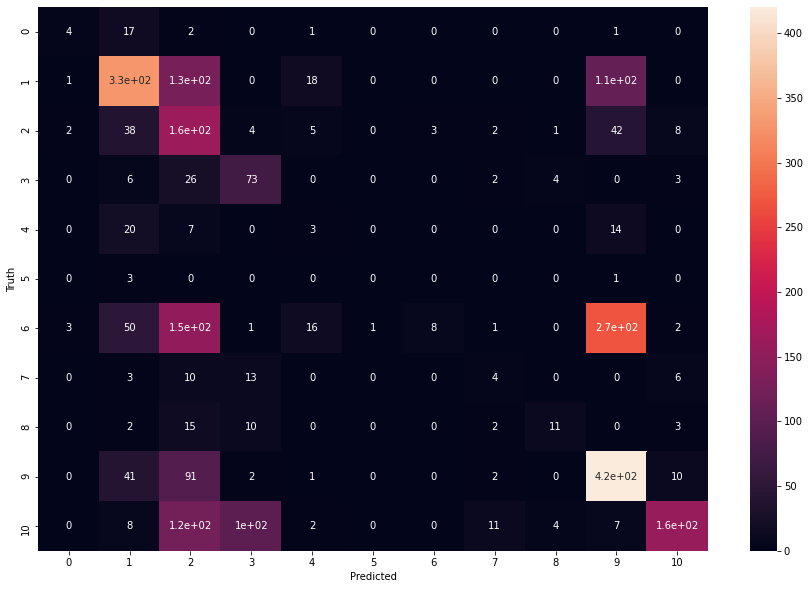

In [86]:
cm_SVM = confusion_matrix(test_kingdom_enc.iloc[:,1], y_predict_SVM_ridge)
plt.figure(figsize = (15,10))
sns.heatmap(cm_SVM, annot = True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

<Figure size 1440x1440 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:>

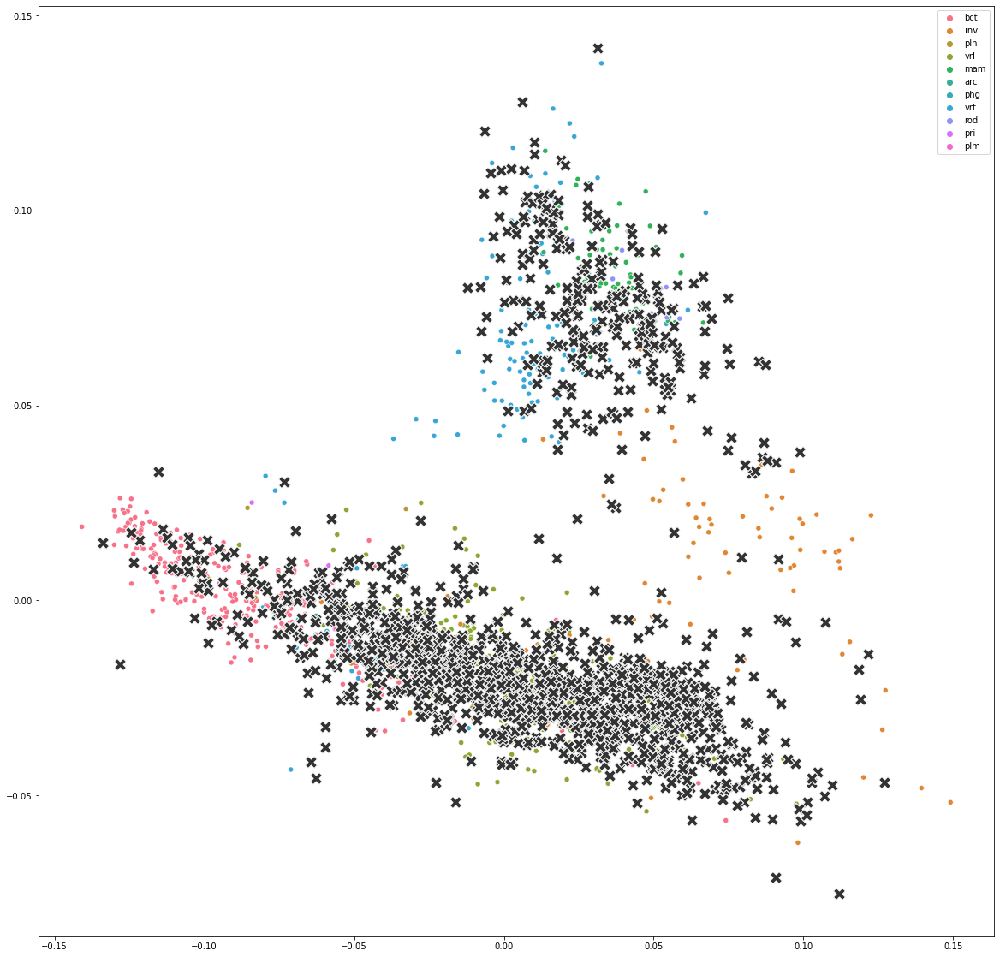

In [87]:
mask = y_predict_SVM_ridge == test_kingdom_enc.iloc[:,1]
errors = np.where(mask == False)

pca = PCA(n_components=2)         #Specifying that we want only 2 components

X_test_PCA = pca.fit_transform(X_test)             #Transform our data in a smaller space and plot the data
X_test_PCA = np.c_[ X_test_PCA, test_kingdom]
plt.figure(figsize = (20,20))
sns.scatterplot(x = X_test_PCA[:,0], y = X_test_PCA[:,1], hue = X_test_PCA[:,2],  data = X_test_PCA)

test_errors = X_test_PCA[errors]

#plt.figure(figsize = (20,20))
sns.scatterplot(x = test_errors[:,0], y = test_errors[:,1],  data = test_errors, marker = 'X', s = 200, color = '.2')

Even in this case we can see that the majority of the errors derive from the two zones where we have different classes overlapped.